# Comparaison méthodes clustering + Manuel +Semi-auto

In [1]:
%matplotlib inline
from nuscenes.nuscenes import NuScenes
nusc = NuScenes(version='v1.0-mini', dataroot='/Users/tiffanydarini/nuscenes-devkit/python-sdk/tutorials/data/sets/nuscenes/v1.0-mini', verbose=True)

Loading NuScenes tables for version v1.0-mini...
23 category,
8 attribute,
4 visibility,
911 instance,
12 sensor,
120 calibrated_sensor,
31206 ego_pose,
8 log,
10 scene,
404 sample,
31206 sample_data,
18538 sample_annotation,
4 map,
Done loading in 0.359 seconds.
Reverse indexing ...
Done reverse indexing in 0.1 seconds.


### Fonction utiles et imports nécessaires

In [2]:
# Fonction qui renvoie les tables ego_pose d'une scène donnée
def get_poses(scene_token):
    pose_list = []
    scene_rec = nusc.get('scene', scene_token)
    sample_rec = nusc.get('sample', scene_rec['first_sample_token'])
    sd_rec = nusc.get('sample_data', sample_rec['data']['LIDAR_TOP'])
    
    ego_pose = nusc.get('ego_pose', sd_rec['token'])
    pose_list.append(ego_pose)

    while sd_rec['next'] != '':
        sd_rec = nusc.get('sample_data', sd_rec['next'])
        ego_pose = nusc.get('ego_pose', sd_rec['token'])
        pose_list.append(ego_pose)

    return pose_list

In [3]:
# On crée une fonction qui renvoie la liste des rangs dans les listes X,Y des objets immobiles de 
# cette liste et donc d'une même catégorie, ainsi que la liste des objets mobiles 
from math import sqrt

def immobile(X,Y):
    Immo = []
    Mobile = []
    n = len(X) # Nombre d'élément dans la catégorie 
    for i in range(0,n-1):
        X_coord = X[i]
        Y_coord = Y[i]
        if len(X_coord)==1 :
            Immo.append(i)
        else : 
            d = 0 
            for k in range(0,len(X_coord)-1):
                d+= sqrt((X_coord[k+1]-X_coord[k])**2+(Y_coord[k+1]-Y_coord[k])**2)
            if d<2 : # Si la distance totale parcourue par l'objet est inférieur à 2m, on considère que l'objet bouge pas
                Immo.append(i)
            else :
                Mobile.append(i)
    return Immo,Mobile  

In [4]:
from dtw import *
import matplotlib.pyplot as plt
from datetime import timedelta

Importing the dtw module. When using in academic works please cite:
  T. Giorgino. Computing and Visualizing Dynamic Time Warping Alignments in R: The dtw Package.
  J. Stat. Soft., doi:10.18637/jss.v031.i07.



In [5]:
import numpy as np 
from math import sqrt 

# Fonction qui renvoie la matrice des distances 
def Matrice_distance(X_ego,Y_ego,X_veh,Y_veh):
    M = np.zeros((len(X_veh),len(X_ego)))
    for i in range(0,len(X_veh)):
        for j in range(0,len(X_ego)):
            #M[i,j] = sqrt((X_veh[len(X_veh)-1-i]-X_ego[j])**2+(Y_veh[len(Y_veh)-1-i]-Y_ego[j])**2)
            M[i,j] = sqrt((X_veh[i]-X_ego[j])**2+(Y_veh[i]-Y_ego[j])**2)
    return M 
     

In [6]:
import numpy as np 
from math import sqrt 

# Fonction qui renvoie la matrice des distances entre 
# les pts qui interagissent dans le temps 

def M_distance_time(X_ego,Y_ego,T_ego,X_veh,Y_veh,T_veh):
    
    debut = max(T_ego[0],T_veh[0]) # Temps début detection vehicule 1 
    fin = min(T_ego[len(T_ego)-1],T_veh[len(T_veh)-1]) # Temps fin detection vehicule 1 

    # On va créer la liste des indices des élements du veh 1 qui sont en même temps que le veh 2
    L_indice_ego = []
    for k in range(0,len(T_ego)):
        if debut<=T_ego[k]<=fin:
            L_indice_ego.append(k)
            
    # Pareil pour le veh 
    L_indice_veh = []
    for k in range(0,len(T_veh)):
        if debut<=T_veh[k]<=fin:
            L_indice_veh.append(k)
    
    M = np.zeros((len(L_indice_veh),len(L_indice_ego)))
    for i in range(0,len(L_indice_veh)):
        for j in range(0,len(L_indice_ego)):
            M[i,j] = sqrt((X_veh[L_indice_veh[i]]-X_ego[L_indice_ego[j]])**2+(Y_veh[L_indice_veh[i]]-Y_ego[L_indice_ego[j]])**2)
    
    return M 

In [7]:
# Pour normaliser le calcul de DTW, on va créer une fonction qui calcule
# la distance parcourue par un véhicule au cours de la scène, en prenant
# en entrée ses coordonnées

def distance_parcourue(X,Y,Z):
    D =[0]
    for k in range(0,len(X)-1):
        d = D[k]+ sqrt((X[k+1]-X[k])**2+(Y[k+1]-Y[k])**2+(Z[k+1]-Z[k])**2)
        D.append(d)
    return D[len(D)-1]

#### Fenêtre glissante

In [8]:
## Fonction qui renvoie une dataframe avec les valeurs de dtw calculés sur des intervalles de temps d'une seconde : 

#imports nécessaires
import matplotlib.pyplot as plt
from math import sqrt
import datetime 
from datetime import timedelta
from dtw import *
import pandas as pd

def dtw_glissante(scene_name):
    
    # On crée une dataframe 
    df = pd.DataFrame()
    L_intervalle = [[k,k+1] for k in range(0,20)]
    df['index']= L_intervalle
    df.set_index('index',inplace=True)
    df.index.name = None
    
    scene_token = nusc.field2token('scene','name',scene_name)[0]
    sample_token = nusc.field2token('sample','scene_token',scene_token)# Ensemble des token des échantillons de la scene 
    
    # Pour tracer la trajectoire du véhicule ego
    Liste_ego_poses = get_poses(scene_token) 
    X_coord =[]
    Y_coord =[]
    Z_coord =[]
    T_timestamp = [] # liste des timestamps
    for k in range(0,len(Liste_ego_poses)):
        X_coord.append(Liste_ego_poses[k]['translation'][0])
        Y_coord.append(Liste_ego_poses[k]['translation'][1])
        Z_coord.append(Liste_ego_poses[k]['translation'][2])
        T_timestamp.append(Liste_ego_poses[k]['timestamp'])
        
    # Ensemble des sample_annotation de la scène :
    sample_annotation_token = []
    for k in sample_token : 
        L = nusc.field2token('sample_annotation','sample_token',k)
        sample_annotation_token = sample_annotation_token + L
    
    # On créé la liste des token des instances présents dans les sample_annotation
    L_instance_token = []
    for k in sample_annotation_token :
        exemple = nusc.get('sample_annotation', k)
        L_instance_token.append(exemple['instance_token'])
    # Puisque pour un même objet, on peut avoir plusieurs annotations, on supprime les doublons de L
    L_instance_token = list(set(L_instance_token))
    
    # Liste des catégories d'objet dans la scène 
    L_category_name = []
    for k in sample_annotation_token :
        exemple = nusc.get('sample_annotation', k)
        L_category_name.append(exemple['category_name'])
    L_category_name = list(set(L_category_name)) #on supprime les doublons 
   
    L_vehicule = ['vehicle.bicycle','vehicle.bus.bendy','vehicle.bus.rigid','vehicle.car','vehicle.construction','vehicle.emergency.ambulance','vehicle.emergency.police','vehicle.motorcycle','vehicle.trailer','vehicle.truck']
    
    L_category_name = [k for k in L_category_name if k in L_vehicule]
    
    # Boucle sur chaque catégorie trouvée
    for j in range(0,len(L_category_name)):   
        catego_name = L_category_name[j]
        catego_token = nusc.field2token('category','name',catego_name)
        category = nusc.get('category',catego_token[0])

        # Ensemble des instances appartenant à la fois à la scène et à la catégorie
        L_instance_category = nusc.field2token('instance','category_token',catego_token[0]) # instance dans la catégorie
        L_instance_category = [x for x in L_instance_category if x in L_instance_token]# et dans la scène 
        L_instance_category
        
        # Il peut y avoir plusieurs éléments de la catégorie dans la scène, ici chaque ligne de L représente 
        # les token des sample_annotation pour un élément de cette catégorie. 

        L=[]
        for k in L_instance_category : 
            instance_category = nusc.get('instance',k)
            nbr_annotations = instance_category['nbr_annotations']
            if nbr_annotations == 1:
                L.append([instance_category['first_annotation_token']])
            else : 
                H = []
                first_token = instance_category['first_annotation_token']
                last_token = instance_category['last_annotation_token']
                current_token = first_token 
        
                s = 0 
                while s!= nbr_annotations :
                    current_ann = nusc.get('sample_annotation', current_token)
                    H.append(current_ann['token'])
                    current_token = current_ann['next'] #On passe au suivant
                    s+=1
                L.append(H)
        
        # Maintenant qu'on a les token de tous les sample_annotation pour tous les éléments d'une même catégorie, 
        # on va pouvoir récupérer leurs positions et tracer leurs trajectoires

        X = []
        Y = []
        Z = []
        T_time = []
        for k in L :
            x = []
            y = []
            z = []
            t=[]
            for j in k :
                sample_annotation = nusc.get('sample_annotation',j)
                x.append(sample_annotation['translation'][0])
                y.append(sample_annotation['translation'][1])
                z.append(sample_annotation['translation'][2])
                t.append(nusc.get('sample',sample_annotation['sample_token'])['timestamp'])
            X.append(x)
            Y.append(y)
            Z.append(z)
            T_time.append(t)
    
        # On crée les listes des objets immobiles et mobiles de la catégorie
        Immo, Mobile = immobile(X,Y)
        
        # On conserve uniquement les objets mobiles 
        X_mobile=[X[i] for i in Mobile]
        Y_mobile=[Y[i] for i in Mobile]
        Z_mobile=[Z[i] for i in Mobile]
        T_mobile = [T_time[i] for i in Mobile]
        
        if len(X_mobile)>0:
        
            for i in range(0,len(X_mobile)):
            
                L_df = []
                # On fait une boucle sur les intervalles de temps 
                for k in range(0,20):
                    current_intervalle = [k,k+1]
                    # On crée les listes des coordonnées qu'on va garder ie qui sont dans l'intervalle de temps ci-dessus
                    Lx_pt_veh = []
                    Ly_pt_veh = []
                    Lt_pt_veh = []
                    Lx_pt_ego = []
                    Ly_pt_ego = []
                    Lt_pt_ego = []
                
                    # On remplit avec les pts du véhicule dont le timestamp est dans l'intervalle 
                    for s in range(len(X_mobile[i])):
                        tveh = (datetime.datetime.fromtimestamp(T_mobile[i][s]/1e6)-datetime.datetime.fromtimestamp(T_timestamp[0]/ 1e6)).total_seconds()
                        if tveh <= current_intervalle[1] and tveh >= current_intervalle[0] :
                            Lx_pt_veh.append(X_mobile[i][s])
                            Ly_pt_veh.append(Y_mobile[i][s])
                            Lt_pt_veh.append(T_mobile[i][s])
                    
                
                
                    # On remplit avec les pts du véhicule ego dont le timestamp est dans l'intervalle 
                    for s in range(len(X_coord)):
                        tego = (datetime.datetime.fromtimestamp(T_timestamp[s]/1e6)-datetime.datetime.fromtimestamp(T_timestamp[0]/ 1e6)).total_seconds()
                        if tego <= current_intervalle[1] and tego >= current_intervalle[0]:
                            Lx_pt_ego.append(X_coord[s])
                            Ly_pt_ego.append(Y_coord[s])
                            Lt_pt_ego.append(T_timestamp[s])
                
                            
                    if len(Lx_pt_veh)==0:
                        L_df.append(np.nan)
                    else :
                        #M_distance = M_distance_time(Lx_pt_ego,Ly_pt_ego,Lt_pt_ego,Lx_pt_veh,Ly_pt_veh,Lt_pt_veh)
                        M_distance = Matrice_distance(Lx_pt_ego,Ly_pt_ego,Lx_pt_veh,Ly_pt_veh)
                        alignment = dtw(M_distance)
                        distance = alignment.normalizedDistance
                        L_df.append(distance) 


                nom = catego_name +' '+str(i+1)
                df[nom]= L_df
    
    return df

#M_distance_time(X_coord,Y_coord,T_timestamp,X_mobile[i],Y_mobile[i],T_mobile[i])

#### Produit scalaire entre les vecteurs

In [9]:
# Fonction qui renvoie la matrice des produits scalaires
import numpy as np

def Matrice_produit_scalaire(X_coord,Y_coord,T_timestamp,X_veh,Y_veh,T_veh):
    
        
    debut = max(T_timestamp[0],T_veh[0]) # Temps début detection vehicule 1 
    fin = min(T_timestamp[len(T_timestamp)-1],T_veh[len(T_veh)-1]) # Temps fin detection vehicule 1 

    # On va créer la liste des indices des élements du veh 1 qui sont en même temps que le veh 2
    L_indice_ego = []
    for k in range(0,len(T_timestamp)):
        if debut<=T_timestamp[k]<=fin:
            L_indice_ego.append(k)
            
    # Pareil pour le veh 
    L_indice_veh = []
    for k in range(0,len(T_veh)):
        if debut<=T_veh[k]<=fin:
            L_indice_veh.append(k)
    
    # On crée la liste des vecteurs pour le véhicule ego avec les points qu'on peut garder
    V_ego = []
    for k in range(0,len(L_indice_ego)-1):
        t2 = datetime.datetime.fromtimestamp(T_timestamp[L_indice_ego[k+1]]/ 1e6)
        t1 = datetime.datetime.fromtimestamp(T_timestamp[L_indice_ego[k]]/ 1e6)
        t = (t2-t1).total_seconds()
        v = np.array([X_coord[L_indice_ego[k+1]]-X_coord[L_indice_ego[k]],Y_coord[L_indice_ego[k+1]]-Y_coord[L_indice_ego[k]]])/t # Le vecteur a pour norme la vitesse à l'instant k
        V_ego.append(v)
        
        
    # On crée la liste des vecteurs pour le veh avec les points qu'on peut garder
    V = []
    for k in range(0,len(L_indice_veh)-1):
        t2 = datetime.datetime.fromtimestamp(T_veh[L_indice_veh[k+1]]/ 1e6)
        t1 = datetime.datetime.fromtimestamp(T_veh[L_indice_veh[k]]/ 1e6)
        t = (t2-t1).total_seconds()
        v = np.array([X_veh[L_indice_veh[k+1]]-X_veh[L_indice_veh[k]],Y_veh[L_indice_veh[k+1]]-Y_veh[L_indice_veh[k]]])/t
        V.append(v)
        
    # On crée la matrice des produits scalaires : 
    M = np.zeros((len(V),len(V_ego)))
    for i in range(0,len(V)):
        for j in range(0,len(V_ego)):
            M[i,j] = np.dot(V[i],V_ego[j])/(np.linalg.norm(V[i])*np.linalg.norm(V_ego[j]))
    return M 

In [10]:
# Fonction qui renvoie la norme du produit vectoriel divisée par la norme des vecteurs

def Matrice_produit_vectoriel(X_coord,Y_coord,T_timestamp,X_veh,Y_veh,T_veh):
    
         
    debut = max(T_timestamp[0],T_veh[0]) # Temps début detection vehicule 1 
    fin = min(T_timestamp[len(T_timestamp)-1],T_veh[len(T_veh)-1]) # Temps fin detection vehicule 1 

    # On va créer la liste des indices des élements du veh 1 qui sont en même temps que le veh 2
    L_indice_ego = []
    for k in range(0,len(T_timestamp)):
        if debut<=T_timestamp[k]<=fin:
            L_indice_ego.append(k)
            
    # Pareil pour le veh 
    L_indice_veh = []
    for k in range(0,len(T_veh)):
        if debut<=T_veh[k]<=fin:
            L_indice_veh.append(k)
    
    # On crée la liste des vecteurs pour le véhicule ego avec les points qu'on peut garder
    V_ego = []
    for k in range(0,len(L_indice_ego)-1):
        t2 = datetime.datetime.fromtimestamp(T_timestamp[L_indice_ego[k+1]]/ 1e6)
        t1 = datetime.datetime.fromtimestamp(T_timestamp[L_indice_ego[k]]/ 1e6)
        t = (t2-t1).total_seconds()
        v = np.array([X_coord[L_indice_ego[k+1]]-X_coord[L_indice_ego[k]],Y_coord[L_indice_ego[k+1]]-Y_coord[L_indice_ego[k]]])/t # Le vecteur a pour norme la vitesse à l'instant k
        V_ego.append(v)
        
        
    # On crée la liste des vecteurs pour le veh avec les points qu'on peut garder
    V = []
    for k in range(0,len(L_indice_veh)-1):
        t2 = datetime.datetime.fromtimestamp(T_veh[L_indice_veh[k+1]]/ 1e6)
        t1 = datetime.datetime.fromtimestamp(T_veh[L_indice_veh[k]]/ 1e6)
        t = (t2-t1).total_seconds()
        v = np.array([X_veh[L_indice_veh[k+1]]-X_veh[L_indice_veh[k]],Y_veh[L_indice_veh[k+1]]-Y_veh[L_indice_veh[k]]])/t
        V.append(v)

    # On crée la matrice des produits scalaires : 
    M = np.zeros((len(V),len(V_ego)))
    for i in range(0,len(V)):
        for j in range(0,len(V_ego)):
            M[i,j] = np.linalg.norm(np.cross(V[i],V_ego[j]))/(np.linalg.norm(V[i])*np.linalg.norm(V_ego[j]))
    return M 

In [11]:
# Fonction qui renvoie la vitesse moyenne de deux véhicules pendant le temps où ils interagissent 

def vitesse_moyenne(X_coord,Y_coord,T_timestamp,X_veh,Y_veh,T_veh):
    
    debut = max(T_timestamp[0],T_veh[0]) # Temps début detection vehicule 1 
    fin = min(T_timestamp[len(T_timestamp)-1],T_veh[len(T_veh)-1]) # Temps fin detection vehicule 1 

    # On va créer la liste des indices des élements du veh 1 qui sont en même temps que le veh 2
    L_indice_ego = []
    for k in range(0,len(T_timestamp)):
        if debut<=T_timestamp[k]<=fin:
            L_indice_ego.append(k)
            
    # Pareil pour le veh 
    L_indice_veh = []
    for k in range(0,len(T_veh)):
        if debut<=T_veh[k]<=fin:
            L_indice_veh.append(k)
    
    # On crée la liste des vecteurs pour le véhicule ego avec les points qu'on peut garder
    V_ego = []
    for k in range(0,len(L_indice_ego)-1):
        t2 = datetime.datetime.fromtimestamp(T_timestamp[L_indice_ego[k+1]]/ 1e6)
        t1 = datetime.datetime.fromtimestamp(T_timestamp[L_indice_ego[k]]/ 1e6)
        t = (t2-t1).total_seconds()
        v = np.array([X_coord[L_indice_ego[k+1]]-X_coord[L_indice_ego[k]],Y_coord[L_indice_ego[k+1]]-Y_coord[L_indice_ego[k]]])/t # Le vecteur a pour norme la vitesse à l'instant k
        V_ego.append(v)
    # Il faut créer le vecteur des normes de V_ego qui contient lui que des vecteurs 
    v_ego_moy = np.mean([np.linalg.norm(V_ego[i]) for i in range(0,len(V_ego))])
        
    # On crée la liste des vecteurs pour le veh avec les points qu'on peut garder
    V = []
    for k in range(0,len(L_indice_veh)-1):
        t2 = datetime.datetime.fromtimestamp(T_veh[L_indice_veh[k+1]]/ 1e6)
        t1 = datetime.datetime.fromtimestamp(T_veh[L_indice_veh[k]]/ 1e6)
        t = (t2-t1).total_seconds()
        v = np.array([X_veh[L_indice_veh[k+1]]-X_veh[L_indice_veh[k]],Y_veh[L_indice_veh[k+1]]-Y_veh[L_indice_veh[k]]])/t
        V.append(v)
    v_veh_moy = np.mean([np.linalg.norm(V[i]) for i in range(0,len(V))])
        
    return v_ego_moy,v_veh_moy

### Création des dataframes contenant les indicateurs 

In [12]:
#imports nécessaires
import matplotlib.pyplot as plt
from math import sqrt
import datetime 
from datetime import timedelta
from dtw import *
import pandas as pd
from statistics import mean

def indicateur_similarite(scene_name):
    
    # On crée une dataframe vide 
    df = pd.DataFrame()
    # Ligne de la dataframe 
    L_ligne = ['scene','Catégorie Véhicule 1','Numéro Véhicule 1','Catégorie Véhicule 2',\
               'Numéro Véhicule 2','Vitesse moyenne veh 1','Vitesse moyenne veh 2',\
               "Durée d'interaction",'DTW normalisée','Distance instantannée moyenne',\
               'Distance instantannée minimale','Distance instantannée maximale','TimeLag moyen horizontal',\
               'TimeLag moyen vertical',"Indicateur d'orthogonalité moyen","Indicateur d'orthogonalité min",\
               "Indicateur d'orthogonalité max",'Indicateur de colinéarité moyen',\
               'Indicateur de colinéarité min','Indicateur de colinéarité max','Sens',\
               'Distance minimale dans matrice distance','Distance maximale dans matrice distance',\
               'Distance moyenne dans matrice distance']
    # Les lignes en plus : 'Time log moyen'
    # On met ça en index 
    df['index']= L_ligne
    df.set_index('index',inplace=True)
    df.index.name = None
    
    # Dataframe des fenêtre glissantes 
    df_glissante = dtw_glissante(scene_name) 
    
    scene_token = nusc.field2token('scene','name',scene_name)[0]
    sample_token = nusc.field2token('sample','scene_token',scene_token)# Ensemble des token des échantillons de la scene 
    
    # Pour tracer la trajectoire du véhicule ego
    Liste_ego_poses = get_poses(scene_token) 
    X_coord =[]
    Y_coord =[]
    Z_coord =[]
    T_timestamp = [] # liste des timestamps
    for k in range(0,len(Liste_ego_poses)):
        X_coord.append(Liste_ego_poses[k]['translation'][0])
        Y_coord.append(Liste_ego_poses[k]['translation'][1])
        Z_coord.append(Liste_ego_poses[k]['translation'][2])
        T_timestamp.append(Liste_ego_poses[k]['timestamp'])
        
    # Ensemble des sample_annotation de la scène :
    sample_annotation_token = []
    for k in sample_token : 
        L = nusc.field2token('sample_annotation','sample_token',k)
        sample_annotation_token = sample_annotation_token + L
    
    # On créé la liste des token des instances présents dans les sample_annotation
    L_instance_token = []
    for k in sample_annotation_token :
        exemple = nusc.get('sample_annotation', k)
        L_instance_token.append(exemple['instance_token'])
    # Puisque pour un même objet, on peut avoir plusieurs annotations, on supprime les doublons de L
    L_instance_token = list(set(L_instance_token))
    
    # Liste des catégories d'objet dans la scène 
    L_category_name = []
    for k in sample_annotation_token :
        exemple = nusc.get('sample_annotation', k)
        L_category_name.append(exemple['category_name'])
    L_category_name = list(set(L_category_name)) #on supprime les doublons 
   
    L_vehicule = ['vehicle.bicycle','vehicle.bus.bendy','vehicle.bus.rigid','vehicle.car','vehicle.construction','vehicle.emergency.ambulance','vehicle.emergency.police','vehicle.motorcycle','vehicle.trailer','vehicle.truck']
    
    L_category_name = [k for k in L_category_name if k in L_vehicule]
    L_category_name.sort()
    
    # Boucle sur chaque catégorie trouvée
    for j in range(0,len(L_category_name)):   
        catego_name = L_category_name[j]
        catego_token = nusc.field2token('category','name',catego_name)
        category = nusc.get('category',catego_token[0])

        # Ensemble des instances appartenant à la fois à la scène et à la catégorie
        L_instance_category = nusc.field2token('instance','category_token',catego_token[0]) # instance dans la catégorie
        L_instance_category = [x for x in L_instance_category if x in L_instance_token]# et dans la scène 
        L_instance_category
        
        # Il peut y avoir plusieurs éléments de la catégorie dans la scène, ici chaque ligne de L représente 
        # les token des sample_annotation pour un élément de cette catégorie. 

        L=[]
        for k in L_instance_category : 
            instance_category = nusc.get('instance',k)
            nbr_annotations = instance_category['nbr_annotations']
            if nbr_annotations == 1:
                L.append([instance_category['first_annotation_token']])
            else : 
                H = []
                first_token = instance_category['first_annotation_token']
                last_token = instance_category['last_annotation_token']
                current_token = first_token 
        
                s = 0 
                while s!= nbr_annotations :
                    current_ann = nusc.get('sample_annotation', current_token)
                    H.append(current_ann['token'])
                    current_token = current_ann['next'] #On passe au suivant
                    s+=1
                L.append(H)
        
        # Maintenant qu'on a les token de tous les sample_annotation pour tous les éléments d'une même catégorie, 
        # on va pouvoir récupérer leurs positions et tracer leurs trajectoires

        X = []
        Y = []
        Z = []
        T_time = []
        for k in L :
            x = []
            y = []
            z = []
            t=[]
            for j in k :
                sample_annotation = nusc.get('sample_annotation',j)
                x.append(sample_annotation['translation'][0])
                y.append(sample_annotation['translation'][1])
                z.append(sample_annotation['translation'][2])
                t.append(nusc.get('sample',sample_annotation['sample_token'])['timestamp'])
            X.append(x)
            Y.append(y)
            Z.append(z)
            T_time.append(t)
    
        # On crée les listes des objets immobiles et mobiles de la catégorie
        Immo, Mobile = immobile(X,Y)
        
        # On conserve uniquement les objets mobiles 
        X_mobile=[X[i] for i in Mobile]
        Y_mobile=[Y[i] for i in Mobile]
        Z_mobile=[Z[i] for i in Mobile]
        T_mobile = [T_time[i] for i in Mobile]
        
        for i in range(0,len(X_mobile)):
            L_objet = [] 
            # nom du véhicule 
            nom = catego_name +' '+str(i+1)
            
            ## Scene 
            L_objet.append(scene_name)
            
            ## Catégorie Véhicule 1
            L_objet.append('vehicle.ego')
            
            ## Numéro véhicule 1
            L_objet.append(1)
        
            ## Catégoie Véhicule 2
            L_objet.append(catego_name)
            
            ## Catégoie Véhicule 2
            L_objet.append(i+1)
            
            ## Vitesses moyennes 
            v_moy_ego, v_moy_veh = vitesse_moyenne(X_coord,Y_coord,T_timestamp,X_mobile[i],Y_mobile[i],T_mobile[i])
            L_objet.append(v_moy_ego)
            L_objet.append(v_moy_veh)
            
            ## Durée d'interaction 
            debut = max(T_mobile[i][0],T_timestamp[0])
            fin = min(T_mobile[i][-1],T_timestamp[-1])
            temps_ego = (datetime.datetime.fromtimestamp(T_timestamp[-1]/1e6)-datetime.datetime.fromtimestamp(T_timestamp[0]/ 1e6)).total_seconds()
            t_total = (datetime.datetime.fromtimestamp(fin/1e6)-datetime.datetime.fromtimestamp(debut/ 1e6)).total_seconds()
            L_objet.append(t_total/temps_ego)
            #L_objet.append(t_total)
            
            ## DTW normalisée
            #M_distance = Matrice_distance(X_coord,Y_coord,X_mobile[i],Y_mobile[i])
            M_distance = M_distance_time(X_coord,Y_coord,T_timestamp,X_mobile[i],Y_mobile[i],T_mobile[i])
            alignment = dtw(M_distance)
            distance = alignment.normalizedDistance
            L_objet.append(distance)
            
            Chemin = [[alignment.index1[k],alignment.index2[k]] for k in range(0,len(alignment.index1))]
            
            ## Distance instannée moyenne 
            L_objet.append(df_glissante[nom].mean())
            
            ## Distance instannée minimale
            L_objet.append(df_glissante[nom].min())
            
            ## Distance instannée maximale
            L_objet.append(df_glissante[nom].max())
            
            ## Time log moyen horizontal
            recurrence_0 = list(alignment.index1).count(0)
            indice_max_ego = alignment.index2[recurrence_0-1]
            t_horizontal = (datetime.datetime.fromtimestamp(T_timestamp[indice_max_ego]/1e6)-datetime.datetime.fromtimestamp(T_timestamp[0]/ 1e6)).total_seconds()
            L_objet.append(t_horizontal)
            
            ## Time log moyen vertical
            N = max(alignment.index2)
            recurrence_N = list(alignment.index2).count(N)
            indice_min_veh = alignment.index1[len(alignment.index1)-recurrence_N]
            t_vertical = (datetime.datetime.fromtimestamp(T_mobile[i][max(alignment.index1)]/1e6)-datetime.datetime.fromtimestamp(T_mobile[i][indice_min_veh]/ 1e6)).total_seconds()
            L_objet.append(t_vertical)
            
            ## Indicateur d'orthogonalité moyen : sin 
            M_pv = Matrice_produit_vectoriel(X_coord,Y_coord,T_timestamp,X_mobile[i],Y_mobile[i],T_mobile[i])
            L_pv = [M_pv[i,j] for(i,j) in Chemin[:len(Chemin)] if i<max(alignment.index1) and j<max(alignment.index2)]
            L_objet.append(mean(L_pv))
            
            ## Indicateur d'orthogonalité min 
            L_objet.append(min(L_pv))
            
            ## Indicateur d'orthogonalité max
            L_objet.append(max(L_pv))
            
            ## Indicateur de colinéarité moyen : cos
            M_ps = Matrice_produit_scalaire(X_coord,Y_coord,T_timestamp,X_mobile[i],Y_mobile[i],T_mobile[i])
            L_ps = [M_ps[i,j] for(i,j) in Chemin[:len(Chemin)] if i<max(alignment.index1) and j<max(alignment.index2)]
            L_objet.append(mean(L_ps))
            
            ## Indicateur de colinéarité min
            L_objet.append(min(L_ps))
            
            ## Indicateur de colinéarité max
            L_objet.append(max(L_ps))
            
            ## Sens 
            if mean(L_ps)>0:
                L_objet.append(1)
            else :
                L_objet.append(0)

            ## Distance min dans la matrice 
            L_objet.append(M_distance.min())
            
            ## Distance max dans la matrice 
            L_objet.append(M_distance.max()) 
            
            ## Distance moyenne dans la matrice 
            L_objet.append(M_distance.mean()) 
            
            nom = catego_name +' '+str(i+1)+'/ego dans '+scene_name
            df[nom]=L_objet
    return df.transpose()
    

#### On étend le calcul à une l'étude des interractions entre les véhicules 

In [13]:
#imports nécessaires
import matplotlib.pyplot as plt
from math import sqrt
import datetime 
from datetime import timedelta
from dtw import *
import pandas as pd
from statistics import mean

def indicateur_similarite_entre_veh(scene_name):
    
    # On crée une dataframe vide 
    df = pd.DataFrame()
    # Ligne de la dataframe 
    
    L_ligne = ['scene','Catégorie Véhicule 1','Numéro Véhicule 1','Catégorie Véhicule 2',\
               'Numéro Véhicule 2','Vitesse moyenne veh 1','Vitesse moyenne veh 2',\
               "Durée d'interaction",'DTW normalisée','Distance instantannée moyenne',\
               'Distance instantannée minimale','Distance instantannée maximale','TimeLag moyen horizontal',\
               'TimeLag moyen vertical',"Indicateur d'orthogonalité moyen","Indicateur d'orthogonalité min",\
               "Indicateur d'orthogonalité max",'Indicateur de colinéarité moyen',\
               'Indicateur de colinéarité min','Indicateur de colinéarité max','Sens',\
               'Distance minimale dans matrice distance','Distance maximale dans matrice distance',\
               'Distance moyenne dans matrice distance']
   
    # On met ça en index 
    df['index']= L_ligne
    df.set_index('index',inplace=True)
    df.index.name = None 

    scene_token = nusc.field2token('scene','name',scene_name)[0]
    sample_token = nusc.field2token('sample','scene_token',scene_token)# Ensemble des token des échantillons de la scene 
    
    # Pour tracer la trajectoire du véhicule ego
    Liste_ego_poses = get_poses(scene_token) 
    X_coord =[]
    Y_coord =[]
    Z_coord =[]
    T_timestamp = [] # liste des timestamps
    for k in range(0,len(Liste_ego_poses)):
        X_coord.append(Liste_ego_poses[k]['translation'][0])
        Y_coord.append(Liste_ego_poses[k]['translation'][1])
        Z_coord.append(Liste_ego_poses[k]['translation'][2])
        T_timestamp.append(Liste_ego_poses[k]['timestamp'])
        
    # Ensemble des sample_annotation de la scène :
    sample_annotation_token = []
    for k in sample_token : 
        L = nusc.field2token('sample_annotation','sample_token',k)
        sample_annotation_token = sample_annotation_token + L
    
    # On créé la liste des token des instances présents dans les sample_annotation
    L_instance_token = []
    for k in sample_annotation_token :
        exemple = nusc.get('sample_annotation', k)
        L_instance_token.append(exemple['instance_token'])
    # Puisque pour un même objet, on peut avoir plusieurs annotations, on supprime les doublons de L
    L_instance_token = list(set(L_instance_token))
    
    # Liste des catégories d'objet dans la scène 
    L_category_name = []
    for k in sample_annotation_token :
        exemple = nusc.get('sample_annotation', k)
        L_category_name.append(exemple['category_name'])
    L_category_name = list(set(L_category_name)) #on supprime les doublons 
   
    L_vehicule = ['vehicle.bicycle','vehicle.bus.bendy','vehicle.bus.rigid','vehicle.car','vehicle.construction','vehicle.emergency.ambulance','vehicle.emergency.police','vehicle.motorcycle','vehicle.trailer','vehicle.truck']
    
    L_category_name = [k for k in L_category_name if k in L_vehicule]
    L_category_name.sort()
    
    # Boucle sur chaque catégorie trouvée
    for j in range(0,len(L_category_name)):   
        catego_name = L_category_name[j]
        catego_token = nusc.field2token('category','name',catego_name)
        category = nusc.get('category',catego_token[0])

        # Ensemble des instances appartenant à la fois à la scène et à la catégorie
        L_instance_category = nusc.field2token('instance','category_token',catego_token[0]) # instance dans la catégorie
        L_instance_category = [x for x in L_instance_category if x in L_instance_token]# et dans la scène 
        L_instance_category
        
        # Il peut y avoir plusieurs éléments de la catégorie dans la scène, ici chaque ligne de L représente 
        # les token des sample_annotation pour un élément de cette catégorie. 

        L=[]
        for k in L_instance_category : 
            instance_category = nusc.get('instance',k)
            nbr_annotations = instance_category['nbr_annotations']
            if nbr_annotations == 1:
                L.append([instance_category['first_annotation_token']])
            else : 
                H = []
                first_token = instance_category['first_annotation_token']
                last_token = instance_category['last_annotation_token']
                current_token = first_token 
        
                s = 0 
                while s!= nbr_annotations :
                    current_ann = nusc.get('sample_annotation', current_token)
                    H.append(current_ann['token'])
                    current_token = current_ann['next'] #On passe au suivant
                    s+=1
                L.append(H)
        
        # Maintenant qu'on a les token de tous les sample_annotation pour tous les éléments d'une même catégorie, 
        # on va pouvoir récupérer leurs positions et tracer leurs trajectoires

        X = []
        Y = []
        Z = []
        T_time = []
        for k in L :
            x = []
            y = []
            z = []
            t=[]
            for f in k :
                sample_annotation = nusc.get('sample_annotation',f)
                x.append(sample_annotation['translation'][0])
                y.append(sample_annotation['translation'][1])
                z.append(sample_annotation['translation'][2])
                t.append(nusc.get('sample',sample_annotation['sample_token'])['timestamp'])
            X.append(x)
            Y.append(y)
            Z.append(z)
            T_time.append(t)
    
        # On crée les listes des objets immobiles et mobiles de la catégorie
        Immo, Mobile = immobile(X,Y)
        
        # On conserve uniquement les objets mobiles 
        X_mobile=[X[i] for i in Mobile]
        Y_mobile=[Y[i] for i in Mobile]
        Z_mobile=[Z[i] for i in Mobile]
        T_mobile = [T_time[i] for i in Mobile]
        
        for i in range(0,len(X_mobile)):
            
            if len(X_mobile)>1:
                
                for k in range(i+1,len(X_mobile)):

                    L_objet = [] 
                    # nom du véhicule 
                    nom = catego_name +' '+str(i+1)+' /'+ catego_name+' '+str(k+1)+' '+ scene_name
                    
                    ## Scene_name
                    L_objet.append(scene_name)
                    
                    ## Catégorie Véhicule 1 
                    L_objet.append(catego_name)
                    ## Numéro véhicule 1 
                    L_objet.append(i+1)
                    
                    ## Catégorie Véhicule 2 
                    L_objet.append(catego_name)
                    ## Numéro véhicule 2 
                    L_objet.append(k+1)
                    
                    ## Vitesses moyennes 
                    v_moy_veh1, v_moy_veh2 = vitesse_moyenne(X_mobile[i],Y_mobile[i],T_mobile[i],X_mobile[k],Y_mobile[k],T_mobile[k])
                    L_objet.append(v_moy_veh1)
                    L_objet.append(v_moy_veh2)
                    
                    ## Durée d'interaction 
                    debut = max(T_mobile[i][0],T_mobile[k][0])
                    fin = min(T_mobile[i][-1],T_mobile[k][-1])
                    t_total = (datetime.datetime.fromtimestamp(fin/1e6)-datetime.datetime.fromtimestamp(debut/ 1e6)).total_seconds()
                    temps_max =max((datetime.datetime.fromtimestamp(T_mobile[i][-1]/1e6)-datetime.datetime.fromtimestamp(T_mobile[i][0]/ 1e6)).total_seconds(),(datetime.datetime.fromtimestamp(T_mobile[k][-1]/1e6)-datetime.datetime.fromtimestamp(T_mobile[k][0]/ 1e6)).total_seconds())
                    if t_total >0 :
                        L_objet.append(t_total/temps_max)
                        #L_objet.append(t_total)
                    else :
                        L_objet.append(np.nan)
                        

                    ## DTW normalisée
                    M_distance =M_distance_time(X_mobile[i],Y_mobile[i],T_mobile[i],X_mobile[k],Y_mobile[k],T_mobile[k])
                    
                    if len(M_distance)>0 :
                    
                        alignment = dtw(M_distance)
                        distance = alignment.normalizedDistance
                        L_objet.append(distance)

                        Chemin = [[alignment.index1[k],alignment.index2[k]] for k in range(0,len(alignment.index1))]

                        ### Fenêtre glissante 

                        L_df = []
                        # On fait une boucle sur les intervalles de temps 
                        for m in range(0,20):
                            current_intervalle = [m,m+1]
                            # On crée les listes des coordonnées qu'on va garder ie qui sont dans l'intervalle de temps ci-dessus
                            Lx_pt_veh1 = []
                            Ly_pt_veh1 = []
                            Lt_pt_veh1 = []
                            Lx_pt_veh2 = []
                            Ly_pt_veh2 = []
                            Lt_pt_veh2 = []

                            # On remplit avec les pts du véhicule dont le timestamp est dans l'intervalle 
                            for s in range(len(X_mobile[i])):
                                tveh1 = (datetime.datetime.fromtimestamp(T_mobile[i][s]/1e6)-datetime.datetime.fromtimestamp(T_timestamp[0]/ 1e6)).total_seconds()
                                if tveh1 <= current_intervalle[1] and tveh1 >= current_intervalle[0] :
                                    Lx_pt_veh1.append(X_mobile[i][s])
                                    Ly_pt_veh1.append(Y_mobile[i][s])
                                    Lt_pt_veh1.append(T_mobile[i][s])

                            # On remplit avec les pts du véhicule ego dont le timestamp est dans l'intervalle 
                            for s in range(len(X_mobile[k])):
                                tveh2 = (datetime.datetime.fromtimestamp(T_mobile[k][s]/1e6)-datetime.datetime.fromtimestamp(T_timestamp[0]/ 1e6)).total_seconds()
                                if tveh2 <= current_intervalle[1] and tveh2 >= current_intervalle[0]:
                                    Lx_pt_veh2.append(X_mobile[k][s])
                                    Ly_pt_veh2.append(Y_mobile[k][s])
                                    Lt_pt_veh2.append(T_mobile[k][s])

                            if len(Lx_pt_veh1)>0 and len(Lx_pt_veh2)>0:
                                #M_distance_glissante = M_distance_time(Lx_pt_veh1,Ly_pt_veh1,Lt_pt_veh1,Lx_pt_veh2,Ly_pt_veh2,Lt_pt_veh2)
                                M_distance_glissante = Matrice_distance(Lx_pt_veh2,Ly_pt_veh2,Lx_pt_veh1,Ly_pt_veh1)
                                alignment_glissante = dtw(M_distance_glissante)
                                distance_glissante = alignment_glissante.normalizedDistance
                                L_df.append(distance_glissante) 

                        ## Distance instannée moyenne 
                        L_objet.append(mean(L_df))

                        ## Distance instannée minimale
                        L_objet.append(min(L_df))

                        ## Distance instannée maximale
                        L_objet.append(max(L_df))

                        ## Time log moyen horizontal
                        recurrence_0 = list(alignment.index1).count(0)
                        indice_max_ego = alignment.index2[recurrence_0-1]
                        t_horizontal = (datetime.datetime.fromtimestamp(T_mobile[i][indice_max_ego]/1e6)-datetime.datetime.fromtimestamp(T_mobile[i][0]/ 1e6)).total_seconds()
                        L_objet.append(t_horizontal)

                        ## Time log moyen vertical
                        N = max(alignment.index2)
                        recurrence_N = list(alignment.index2).count(N)
                        indice_min_veh = alignment.index1[len(alignment.index1)-recurrence_N]
                        t_vertical = (datetime.datetime.fromtimestamp(T_mobile[k][max(alignment.index1)]/1e6)-datetime.datetime.fromtimestamp(T_mobile[k][indice_min_veh]/ 1e6)).total_seconds()
                        L_objet.append(t_vertical)

                        ## Indicateur d'orthogonalité : sin 
                        M_pv = Matrice_produit_vectoriel(X_mobile[i],Y_mobile[i],T_mobile[i],X_mobile[k],Y_mobile[k],T_mobile[k])
                        L_pv = [M_pv[i,j] for(i,j) in Chemin[:len(Chemin)] if i<max(alignment.index1) and j<max(alignment.index2)]
                        if len(L_pv)>0:
                            L_objet.append(mean(L_pv))
                            L_objet.append(min(L_pv))
                            L_objet.append(max(L_pv))
                        else :
                            L_objet.append(np.nan)
                            L_objet.append(np.nan)
                            L_objet.append(np.nan)

                        ## Indicateur de colinéarité : cos
                        M_ps = Matrice_produit_scalaire(X_mobile[i],Y_mobile[i],T_mobile[i],X_mobile[k],Y_mobile[k],T_mobile[k])
                        L_ps = [M_ps[i,j] for(i,j) in Chemin[:len(Chemin)] if i<max(alignment.index1) and j<max(alignment.index2)]
                        if len(L_ps)>0:
                            L_objet.append(mean(L_ps))
                            L_objet.append(min(L_ps))
                            L_objet.append(max(L_ps))
                        else : 
                            L_objet.append(np.nan)
                            L_objet.append(np.nan)
                            L_objet.append(np.nan)
                        
                        ## Sens :
                        if len(L_ps)>0 :
                            if mean(L_ps)>0:
                                L_objet.append(1)
                            else :
                                L_objet.append(0)
                        else : 
                            L_objet.append(np.nan)
        
                        ## Distance min dans la matrice 
                        L_objet.append(M_distance.min())

                        ## Distance max dans la matrice 
                        L_objet.append(M_distance.max()) 

                        ## Distance moyenne dans la matrice 
                        L_objet.append(M_distance.mean()) 
                    
                    else : 
                        L_objet = L_objet + [np.nan]*16
                        
                    df[nom]=L_objet
            
            # On s'occuper maintenant des relations inter-catégories 
            for h in range(j+1,len(L_category_name)):   
                catego_name2 = L_category_name[h]
                catego_token2 = nusc.field2token('category','name',catego_name2)
                category2 = nusc.get('category',catego_token2[0])

                # Ensemble des instances appartenant à la fois à la scène et à la catégorie
                L_instance_category2 = nusc.field2token('instance','category_token',catego_token2[0]) # instance dans la catégorie
                L_instance_category2 = [x for x in L_instance_category2 if x in L_instance_token]# et dans la scène 
                # Il peut y avoir plusieurs éléments de la catégorie dans la scène, ici chaque ligne de L représente 
                # les token des sample_annotation pour un élément de cette catégorie. 

                L2=[]
                for k in L_instance_category2 : 
                    instance_category = nusc.get('instance',k)
                    nbr_annotations = instance_category['nbr_annotations']
                    if nbr_annotations == 1:
                        L.append([instance_category['first_annotation_token']])
                    else : 
                        H = []
                        first_token = instance_category['first_annotation_token']
                        last_token = instance_category['last_annotation_token']
                        current_token = first_token 

                        s = 0 
                        while s!= nbr_annotations :
                            current_ann = nusc.get('sample_annotation', current_token)
                            H.append(current_ann['token'])
                            current_token = current_ann['next'] #On passe au suivant
                            s+=1
                        L2.append(H)

                # Maintenant qu'on a les token de tous les sample_annotation pour tous les éléments d'une même catégorie, 
                # on va pouvoir récupérer leurs positions et tracer leurs trajectoires

                X2 = []
                Y2 = []
                Z2 = []
                T2_time = []
                for k in L2 :
                    x = []
                    y = []
                    z = []
                    t=[]
                    for f in k :
                        sample_annotation = nusc.get('sample_annotation',f)
                        x.append(sample_annotation['translation'][0])
                        y.append(sample_annotation['translation'][1])
                        z.append(sample_annotation['translation'][2])
                        t.append(nusc.get('sample',sample_annotation['sample_token'])['timestamp'])
                    X2.append(x)
                    Y2.append(y)
                    Z2.append(z)
                    T2_time.append(t)

                # On crée les listes des objets immobiles et mobiles de la catégorie
                Immo2, Mobile2 = immobile(X2,Y2)

                # On conserve uniquement les objets mobiles 
                X2_mobile=[X2[i] for i in Mobile2]
                Y2_mobile=[Y2[i] for i in Mobile2]
                Z2_mobile=[Z2[i] for i in Mobile2]
                T2_mobile = [T2_time[i] for i in Mobile2]
                
                if len(X2_mobile)>0:
                    
                    for n in range(0,len(X2_mobile)):
                        L_objet = [] 
                        # nom du véhicule 
                        nom = catego_name +' '+str(i+1)+' /'+ catego_name2+' '+str(n+1)+' '+ scene_name

                        ## Scene_name
                        L_objet.append(scene_name)
                        
                         ## Catégorie Véhicule 1 
                        L_objet.append(catego_name)
                        ## Numéro véhicule 1 
                        L_objet.append(i+1)
                    
                        ## Catégorie Véhicule 2 
                        L_objet.append(catego_name2)
                        ## Numéro véhicule 2 
                        L_objet.append(n+1)

                        ## Vitesses moyennes 
                        v_moy_veh1, v_moy_veh2 = vitesse_moyenne(X_mobile[i],Y_mobile[i],T_mobile[i],X2_mobile[n],Y2_mobile[n],T2_mobile[n])
                        L_objet.append(v_moy_veh1)
                        L_objet.append(v_moy_veh2)

                        ## Durée d'interaction 
                        debut = max(T_mobile[i][0],T2_mobile[n][0])
                        fin = min(T_mobile[i][-1],T2_mobile[n][-1])
                        t_total = (datetime.datetime.fromtimestamp(fin/1e6)-datetime.datetime.fromtimestamp(debut/ 1e6)).total_seconds()
                        temps_max =max((datetime.datetime.fromtimestamp(T_mobile[i][-1]/1e6)-datetime.datetime.fromtimestamp(T_mobile[i][0]/ 1e6)).total_seconds(),(datetime.datetime.fromtimestamp(T2_mobile[n][-1]/1e6)-datetime.datetime.fromtimestamp(T2_mobile[n][0]/ 1e6)).total_seconds())
                        if t_total >0 :
                            L_objet.append(t_total/temps_max)
                            #L_objet.append(t_total)
                        else :
                            L_objet.append(np.nan)


                        ## DTW normalisée
                        M_distance =M_distance_time(X_mobile[i],Y_mobile[i],T_mobile[i],X2_mobile[n],Y2_mobile[n],T2_mobile[n])

                        if len(M_distance)>0 :

                            alignment = dtw(M_distance)
                            distance = alignment.normalizedDistance
                            L_objet.append(distance)

                            Chemin = [[alignment.index1[k],alignment.index2[k]] for k in range(0,len(alignment.index1))]

                            ### Fenêtre glissante 

                            L_df = []
                            # On fait une boucle sur les intervalles de temps 
                            for m in range(0,20):
                                current_intervalle = [m,m+1]
                                # On crée les listes des coordonnées qu'on va garder ie qui sont dans l'intervalle de temps ci-dessus
                                Lx_pt_veh1 = []
                                Ly_pt_veh1 = []
                                Lt_pt_veh1 = []
                                Lx_pt_veh2 = []
                                Ly_pt_veh2 = []
                                Lt_pt_veh2 = []

                                # On remplit avec les pts du véhicule dont le timestamp est dans l'intervalle 
                                for s in range(len(X_mobile[i])):
                                    tveh1 = (datetime.datetime.fromtimestamp(T_mobile[i][s]/1e6)-datetime.datetime.fromtimestamp(T_timestamp[0]/ 1e6)).total_seconds()
                                    if tveh1 <= current_intervalle[1] and tveh1 >= current_intervalle[0] :
                                        Lx_pt_veh1.append(X_mobile[i][s])
                                        Ly_pt_veh1.append(Y_mobile[i][s])
                                        Lt_pt_veh1.append(T_mobile[i][s])

                                # On remplit avec les pts du véhicule ego dont le timestamp est dans l'intervalle 
                                for s in range(len(X2_mobile[n])):
                                    tveh2 = (datetime.datetime.fromtimestamp(T2_mobile[n][s]/1e6)-datetime.datetime.fromtimestamp(T_timestamp[0]/ 1e6)).total_seconds()
                                    if tveh2 <= current_intervalle[1] and tveh2 >= current_intervalle[0]:
                                        Lx_pt_veh2.append(X2_mobile[n][s])
                                        Ly_pt_veh2.append(Y2_mobile[n][s])
                                        Lt_pt_veh2.append(T2_mobile[n][s])

                                if len(Lx_pt_veh1)>0 and len(Lx_pt_veh2)>0:
                                    #M_distance_glissante = M_distance_time(Lx_pt_veh1,Ly_pt_veh1,Lt_pt_veh1,Lx_pt_veh2,Ly_pt_veh2,Lt_pt_veh2)
                                    M_distance_glissante = Matrice_distance(Lx_pt_veh2,Ly_pt_veh2,Lx_pt_veh1,Ly_pt_veh1)
                                    alignment_glissante = dtw(M_distance_glissante)
                                    distance_glissante = alignment_glissante.normalizedDistance
                                    L_df.append(distance_glissante) 

                            ## Distance instannée moyenne 
                            L_objet.append(mean(L_df))

                            ## Distance instannée minimale
                            L_objet.append(min(L_df))

                            ## Distance instannée maximale
                            L_objet.append(max(L_df))

                            ## Time log moyen horizontal
                            recurrence_0 = list(alignment.index1).count(0)
                            indice_max_ego = alignment.index2[recurrence_0-1]
                            t_horizontal = (datetime.datetime.fromtimestamp(T_mobile[i][indice_max_ego]/1e6)-datetime.datetime.fromtimestamp(T_mobile[i][0]/ 1e6)).total_seconds()
                            L_objet.append(t_horizontal)

                            ## Time log moyen vertical
                            N = max(alignment.index2)
                            recurrence_N = list(alignment.index2).count(N)
                            indice_min_veh = alignment.index1[len(alignment.index1)-recurrence_N]
                            t_vertical = (datetime.datetime.fromtimestamp(T2_mobile[n][max(alignment.index1)]/1e6)-datetime.datetime.fromtimestamp(T2_mobile[n][indice_min_veh]/ 1e6)).total_seconds()
                            L_objet.append(t_vertical)

                            ## Indicateur d'orthogonalité : sin 
                            M_pv = Matrice_produit_vectoriel(X_mobile[i],Y_mobile[i],T_mobile[i],X2_mobile[n],Y2_mobile[n],T2_mobile[n])
                            L_pv = [M_pv[i,j] for(i,j) in Chemin[:len(Chemin)] if i<max(alignment.index1) and j<max(alignment.index2)]
                            if len(L_pv)>0:
                                L_objet.append(mean(L_pv))
                                L_objet.append(min(L_pv))
                                L_objet.append(max(L_pv))
                            else :
                                L_objet.append(np.nan)
                                L_objet.append(np.nan)
                                L_objet.append(np.nan)

                            ## Indicateur de colinéarité : cos
                            M_ps = Matrice_produit_scalaire(X_mobile[i],Y_mobile[i],T_mobile[i],X2_mobile[n],Y2_mobile[n],T2_mobile[n])
                            L_ps = [M_ps[i,j] for(i,j) in Chemin[:len(Chemin)] if i<max(alignment.index1) and j<max(alignment.index2)]
                            if len(L_ps)>0:
                                L_objet.append(mean(L_ps))
                                L_objet.append(min(L_ps))
                                L_objet.append(max(L_ps))
                            else : 
                                L_objet.append(np.nan)
                                L_objet.append(np.nan)
                                L_objet.append(np.nan)
                                
                            ## Sens :
                            if len(L_ps)>0 :
                                if mean(L_ps)>0:
                                    L_objet.append(1)
                                else :
                                    L_objet.append(0)
                            else : 
                                L_objet.append(np.nan)

                            ## Distance min dans la matrice 
                            L_objet.append(M_distance.min())

                            ## Distance max dans la matrice 
                            L_objet.append(M_distance.max()) 

                            ## Distance moyenne dans la matrice 
                            L_objet.append(M_distance.mean()) 

                        else : 
                            L_objet = L_objet + [np.nan]*16

                        df[nom]=L_objet

    return df.transpose()

### Dataframe finale 

In [14]:
## Dataframe contenant toutes les données pour tous les couples de trajectoires à l'intérieur des 10 scènes 

In [15]:
import time
debut = time.time()
L_scene_name = ['scene-0061','scene-0103','scene-0655','scene-0553','scene-0757','scene-0796','scene-0916','scene-1077','scene-1094','scene-1100']
df_ego = pd.concat([indicateur_similarite(scene_name) for scene_name in L_scene_name])
df_entre_veh = pd.concat([indicateur_similarite_entre_veh(scene_name) for scene_name in L_scene_name])
DF_finale = pd.concat([df_ego,df_entre_veh])
print(time.time()-debut)
#%time

/Users/tiffanydarini/opt/anaconda3/envs/nuscenes/lib/python3.7/site-packages/ipykernel_launcher.py:44: RuntimeWarning: invalid value encountered in double_scalars
/Users/tiffanydarini/opt/anaconda3/envs/nuscenes/lib/python3.7/site-packages/ipykernel_launcher.py:45: RuntimeWarning: invalid value encountered in double_scalars
/Users/tiffanydarini/opt/anaconda3/envs/nuscenes/lib/python3.7/site-packages/numpy/core/fromnumeric.py:3373: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
/Users/tiffanydarini/opt/anaconda3/envs/nuscenes/lib/python3.7/site-packages/numpy/core/_methods.py:170: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


45.05753993988037


In [16]:
DF_finale

,scene,Catégorie Véhicule 1,Numéro Véhicule 1,Catégorie Véhicule 2,Numéro Véhicule 2,Vitesse moyenne veh 1,Vitesse moyenne veh 2,Durée d'interaction,DTW normalisée,Distance instantannée moyenne,...,Indicateur d'orthogonalité moyen,Indicateur d'orthogonalité min,Indicateur d'orthogonalité max,Indicateur de colinéarité moyen,Indicateur de colinéarité min,Indicateur de colinéarité max,Sens,Distance minimale dans matrice distance,Distance maximale dans matrice distance,Distance moyenne dans matrice distance
vehicle.bus.rigid 1/ego dans scene-0061,scene-0061,vehicle.ego,1,vehicle.bus.rigid,1,8.564618,9.255912,0.107044,62.784244,72.53295,...,0.011213,0.000274,0.03069,-0.999907,-1.0,-0.999529,0,53.479254,89.795179,71.922482
vehicle.car 1/ego dans scene-0061,scene-0061,vehicle.ego,1,vehicle.car,1,8.862925,9.459852,0.054837,24.953401,32.364935,...,0.076894,0.063754,0.084432,-0.997027,-0.997966,-0.996429,0,20.739661,38.735602,29.578912
vehicle.car 2/ego dans scene-0061,scene-0061,vehicle.ego,1,vehicle.car,2,6.155384,5.78235,0.600504,15.844434,26.217761,...,0.393398,0.092346,0.996106,0.831509,0.088161,0.995727,1,6.787707,88.709867,33.192634
vehicle.car 3/ego dans scene-0061,scene-0061,vehicle.ego,1,vehicle.car,3,8.564618,11.088804,0.107044,32.294648,38.263151,...,0.059173,0.036886,0.078373,0.99819,0.996924,0.999319,1,23.975892,64.147662,43.973192
vehicle.car 4/ego dans scene-0061,scene-0061,vehicle.ego,1,vehicle.car,4,4.77538,3.222342,1.0,5.050621,14.823187,...,0.035928,0.00008,0.140614,0.998951,0.990065,1.0,1,0.037589,77.803221,25.983685
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
vehicle.car 11 /vehicle.motorcycle 1 scene-1100,scene-1100,vehicle.car,11,vehicle.motorcycle,1,10.122451,6.338455,0.384567,49.083647,46.260902,...,0.991064,0.983084,0.999991,0.12377,0.00419,0.183158,1,30.3152,104.29712,64.656899
vehicle.car 11 /vehicle.motorcycle 2 scene-1100,scene-1100,vehicle.car,11,vehicle.motorcycle,2,10.122451,11.181889,0.750012,12.551868,29.181995,...,0.014729,0.001593,0.041305,0.999805,0.999147,0.999999,1,0.49852,122.125142,46.623162
vehicle.car 12 /vehicle.motorcycle 1 scene-1100,scene-1100,vehicle.car,12,vehicle.motorcycle,1,1.161951,2.08155,0.666705,53.649857,41.041228,...,NaN,NaN,NaN,NaN,NaN,NaN,0,47.61365,78.469695,55.41502
vehicle.car 12 /vehicle.motorcycle 2 scene-1100,scene-1100,vehicle.car,12,vehicle.motorcycle,2,3.024676,10.319906,0.269163,22.700355,22.612802,...,0.159685,0.014357,0.248427,-0.981828,-0.999897,-0.968651,0,11.473515,51.084325,28.863618


#### DBSCAN

In [18]:
# Fonction qui renvoie la liste des numéros de clusters des observations
 
from sklearn.cluster import DBSCAN

def cluster (X,eps, min_samples):
    db= DBSCAN(eps=eps, min_samples=min_samples,algorithm='ball_tree').fit(X)
    core_samples_mask = np.zeros_like(db.labels_, dtype=bool)
    core_samples_mask[db.core_sample_indices_] = True
    labels=db.labels_
    n_clusters_ = len(set(labels)) - (1 if -1 in labels else 0)
    n_noise_ = list(labels).count(-1)
    return labels
    

### Comparaison des résultats 

On va comparer, l'appartenance à un cluster en particulier des individus pour chaque méthode

In [20]:
df_comparaison = pd.DataFrame()
df_comparaison['Couple individus']=list(DF_finale.dropna().index)
df_comparaison['Scene']=list(DF_finale.dropna()['scene'])
df_comparaison

,Couple individus,Scene
0,vehicle.bus.rigid 1/ego dans scene-0061,scene-0061
1,vehicle.car 1/ego dans scene-0061,scene-0061
2,vehicle.car 2/ego dans scene-0061,scene-0061
3,vehicle.car 3/ego dans scene-0061,scene-0061
4,vehicle.car 4/ego dans scene-0061,scene-0061
...,...,...
1236,vehicle.car 11 /vehicle.car 12 scene-1100,scene-1100
1237,vehicle.car 11 /vehicle.motorcycle 1 scene-1100,scene-1100
1238,vehicle.car 11 /vehicle.motorcycle 2 scene-1100,scene-1100
1239,vehicle.car 12 /vehicle.motorcycle 2 scene-1100,scene-1100


In [21]:
# imports nécessaire pour les autres méthodes de clustering
from sklearn.cluster import AgglomerativeClustering
from sklearn.preprocessing import StandardScaler
from sklearn.cluster import KMeans

In [22]:
## On rajoute les numéros de clusters à la df 
DF_bis = DF_finale.copy()
DF_bis = DF_bis.dropna()
DF_bis[list(DF_bis.columns[5:])] = StandardScaler().fit_transform(DF_bis[list(DF_bis.columns[5:])])
# Dbscan
labels_dbscan = cluster (DF_bis[list(DF_bis.columns[5:])],1.5,2)
df_comparaison['Clusters DBscan']=labels_dbscan
# Ward 
clustering_ward = AgglomerativeClustering(18).fit(DF_bis[list(DF_bis.columns[5:])])
labels_ward = clustering_ward.labels_
df_comparaison['Clusters Ward']=labels_ward
# Kmeans
kmeans = KMeans(20, random_state=0).fit(DF_bis[list(DF_bis.columns[5:])])
labels_kmeans = kmeans.labels_
df_comparaison['Clusters Kmeans']=labels_kmeans

df_comparaison

,Couple individus,Scene,Clusters DBscan,Clusters Ward,Clusters Kmeans
0,vehicle.bus.rigid 1/ego dans scene-0061,scene-0061,-1,10,9
1,vehicle.car 1/ego dans scene-0061,scene-0061,0,17,6
2,vehicle.car 2/ego dans scene-0061,scene-0061,1,1,0
3,vehicle.car 3/ego dans scene-0061,scene-0061,2,8,5
4,vehicle.car 4/ego dans scene-0061,scene-0061,-1,5,7
...,...,...,...,...,...
1236,vehicle.car 11 /vehicle.car 12 scene-1100,scene-1100,0,17,6
1237,vehicle.car 11 /vehicle.motorcycle 1 scene-1100,scene-1100,66,7,8
1238,vehicle.car 11 /vehicle.motorcycle 2 scene-1100,scene-1100,2,5,7
1239,vehicle.car 12 /vehicle.motorcycle 2 scene-1100,scene-1100,-1,17,6


On crée une colonne contenant ce qu'on a identifié visuellement pour les comportements des véhicules.

In [23]:
L_manuel = ['Sens inv','Même sens','Traj symétrique','Même sens','Car following direct',\
           'Même sens','Traj symétrique','Car following direct','Sens inv','Sens inv',\
           'Sens inv','Sens inv','Sens inv','Sens inv','Sens inv','Sens inv',\
           'Sens inv','Sens inv','Sens inv','Même sens','Traj symétrique','Même sens',\
           'Car following direct','Même sens','Car following direct','Même sens','Même sens','Même sens',\
           ] # scène 0061
L_manuel = L_manuel + [np.nan]*78 #scène 103

L_manuel = L_manuel + ['Car following direct', 'Traj orthogonales', 'Traj orthogonales',\
     'Traj orthogonales', 'Traj orthogonales','Sens inv','Sens inv',\
     'Traj orthogonales','Inclassable','Inclassable','Inclassable',\
     'Traj orthogonales','Traj orthogonales','Inclassable','Sens inv',\
     'Sens inv','Traj orthogonales','Inclassable','Inclassable','Inclassable',\
     'Inclassable','Inclassable','Inclassable','Inclassable','Inclassable',\
     'Inclassable','Inclassable','Même sens','Inclassable','Traj orthogonales',\
     'Traj orthogonales','Sens inv','Inclassable','Car following indirect',\
     'Inclassable','Traj orthogonales','Traj orthogonales','Sens inv','Inclassable',\
     'Même sens','Inclassable','Inclassable','Inclassable','Inclassable',\
     'Inclassable','Car following indirect','Traj orthogonales','Inclassable',\
     'Traj orthogonales','Traj orthogonales','Inclassable','Traj orthogonales',\
     'Inclassable','Sens inv','Inclassable'] # scène 0655

n = len(DF_finale.dropna())-len(L_manuel) # le nombre de ligne des autres scènes
L_manuel = L_manuel + [np.nan]*n
len(L_manuel)

1241

In [24]:
df_comparaison['Manuel']= L_manuel
df_comparaison

,Couple individus,Scene,Clusters DBscan,Clusters Ward,Clusters Kmeans,Manuel
0,vehicle.bus.rigid 1/ego dans scene-0061,scene-0061,-1,10,9,Sens inv
1,vehicle.car 1/ego dans scene-0061,scene-0061,0,17,6,Même sens
2,vehicle.car 2/ego dans scene-0061,scene-0061,1,1,0,Traj symétrique
3,vehicle.car 3/ego dans scene-0061,scene-0061,2,8,5,Même sens
4,vehicle.car 4/ego dans scene-0061,scene-0061,-1,5,7,Car following direct
...,...,...,...,...,...,...
1236,vehicle.car 11 /vehicle.car 12 scene-1100,scene-1100,0,17,6,NaN
1237,vehicle.car 11 /vehicle.motorcycle 1 scene-1100,scene-1100,66,7,8,NaN
1238,vehicle.car 11 /vehicle.motorcycle 2 scene-1100,scene-1100,2,5,7,NaN
1239,vehicle.car 12 /vehicle.motorcycle 2 scene-1100,scene-1100,-1,17,6,NaN


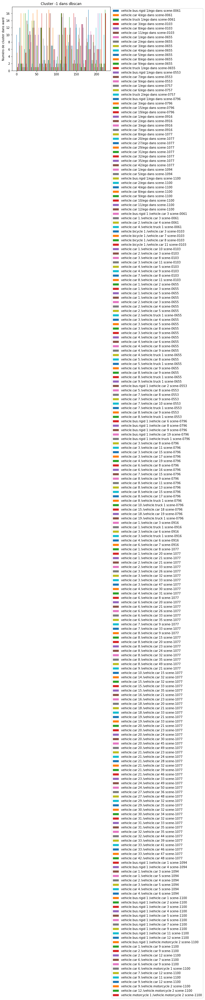

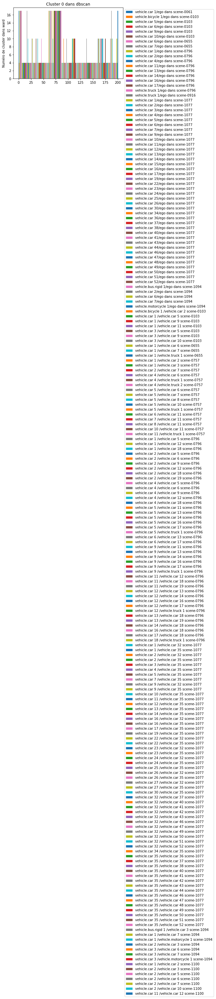

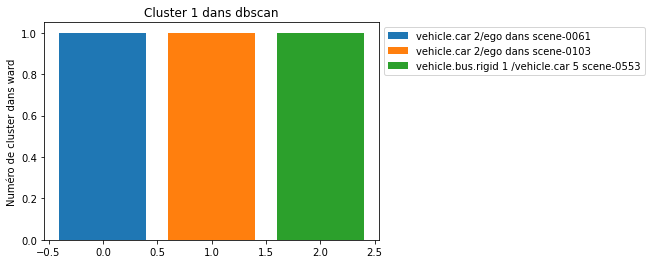

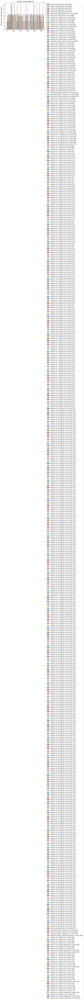

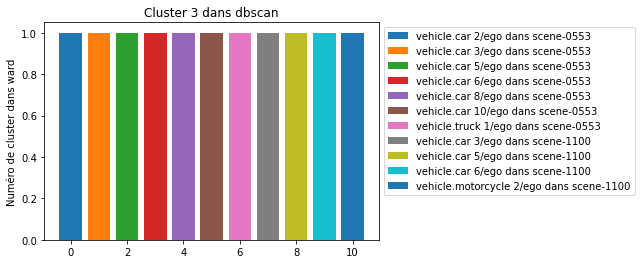

...

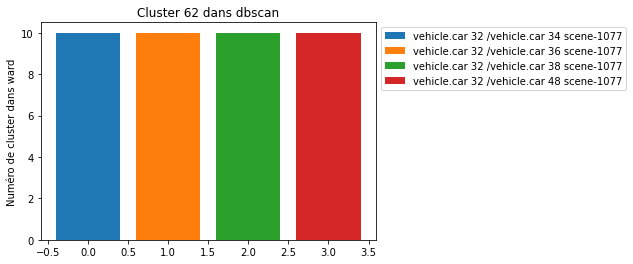

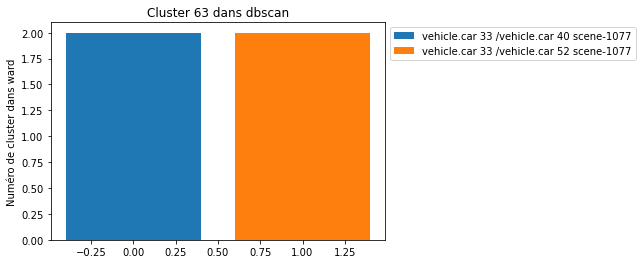

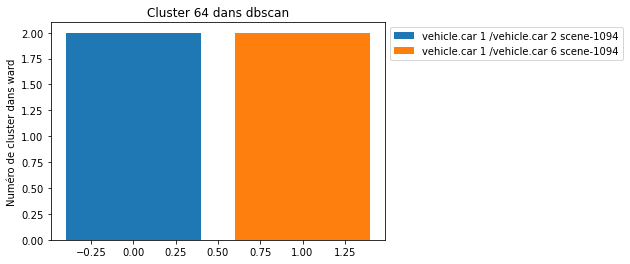

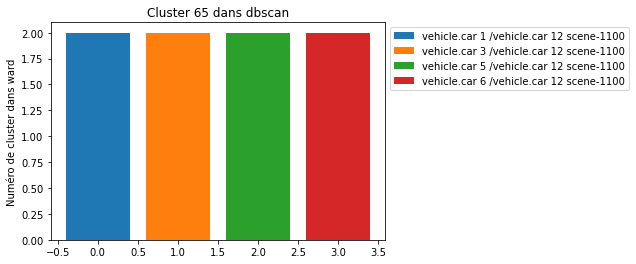

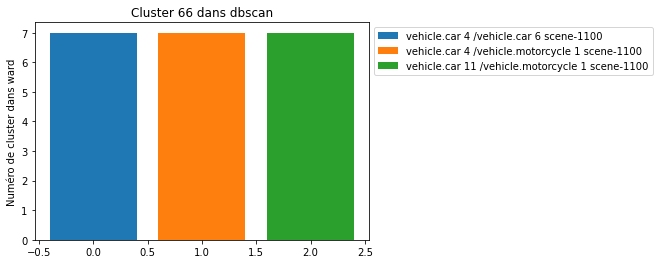

In [25]:
# Répartition des éléments dans ward par rapport à dbscan 
for k in range(-1,int(max(df_comparaison['Clusters DBscan']))+1):
    DF = df_comparaison[df_comparaison['Clusters DBscan']==k][['Couple individus','Clusters Ward','Clusters Kmeans']]
    DF.groupby('Couple individus')
    DF = DF.reset_index(drop=True)
    L = list(DF['Couple individus'].unique())
    plt.figure()
    for j in range(0,len(L)):
        a = DF[DF['Couple individus']==L[j]]
        plt.bar(a.index,a['Clusters Ward'])
    plt.legend(L,bbox_to_anchor=(1, 1.0),loc='best')
    plt.ylabel('Numéro de cluster dans ward')
    plt.title('Cluster '+str(k)+ ' dans dbscan')
    plt.show()

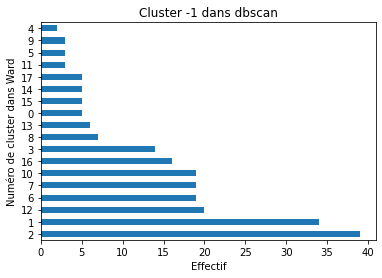

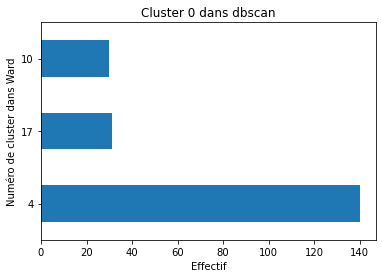

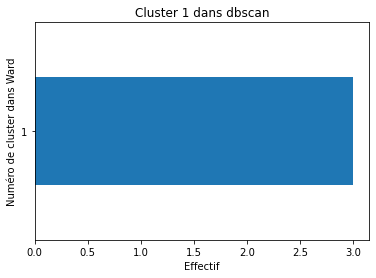

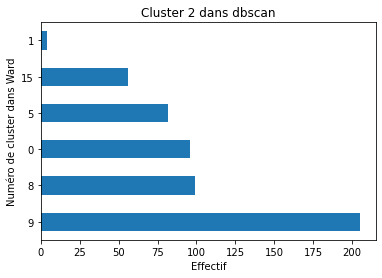

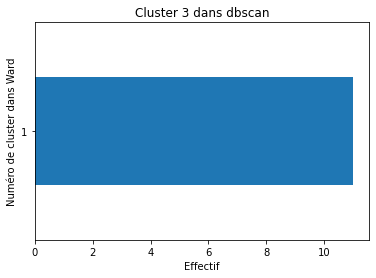

...

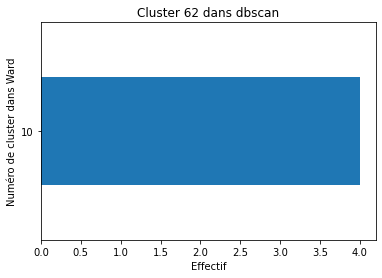

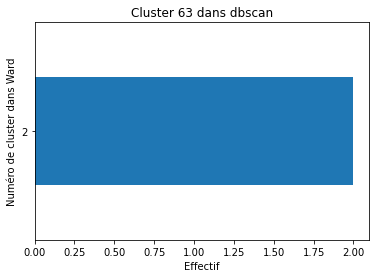

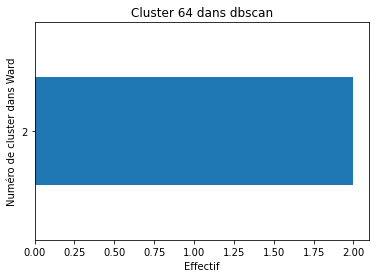

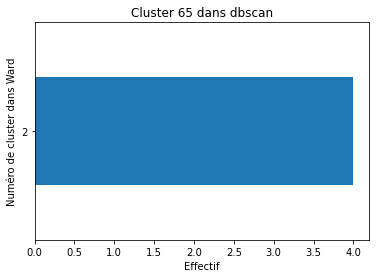

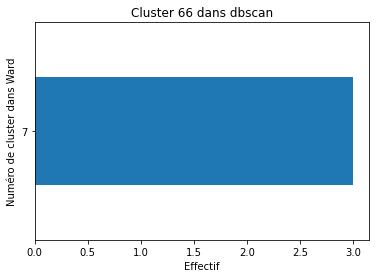

In [26]:
# Histogramme des clusters dans ward par rapport à dbscan 
for k in range(-1,int(max(df_comparaison['Clusters DBscan']))+1):
    DF = df_comparaison[df_comparaison['Clusters DBscan']==k][['Couple individus','Clusters Ward','Clusters Kmeans']]
    DF['Clusters Ward'].value_counts().plot(kind='barh')
    plt.title('Cluster '+str(k)+ ' dans dbscan')
    plt.xlabel('Effectif')
    plt.ylabel('Numéro de cluster dans Ward')
    plt.show()

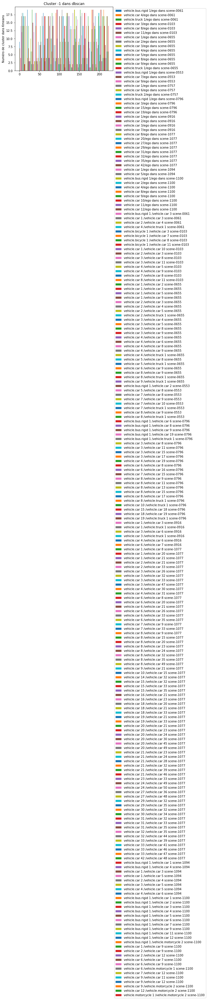

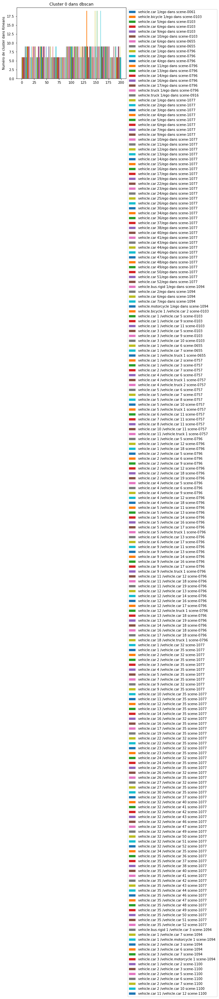

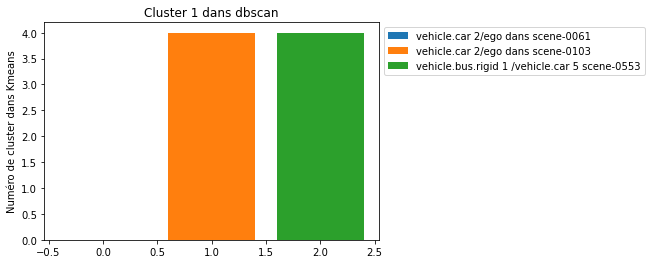

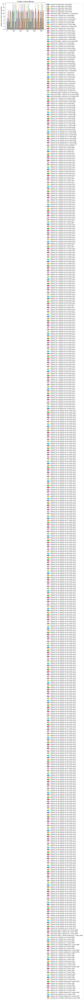

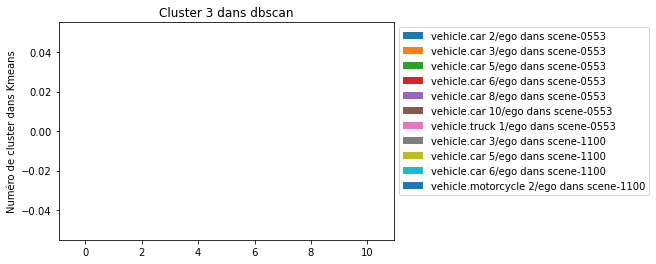

...

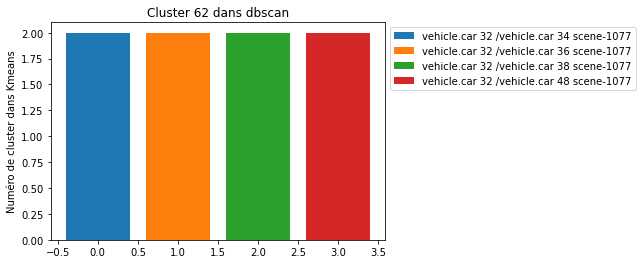

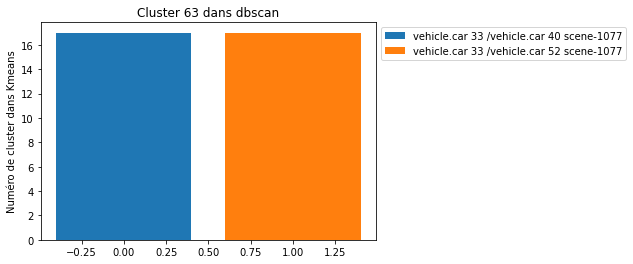

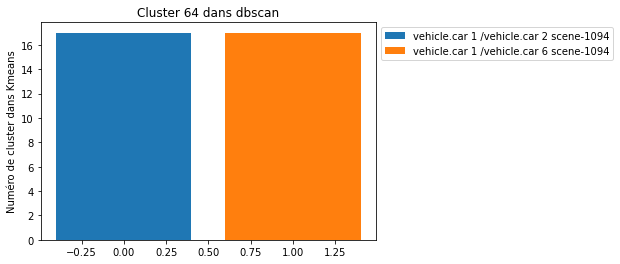

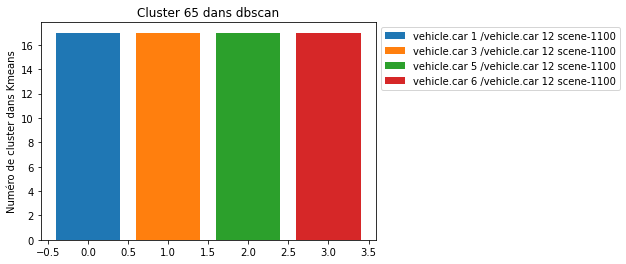

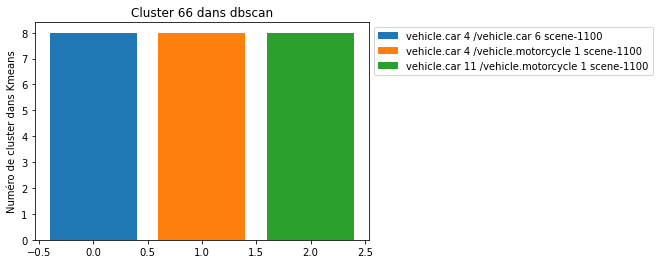

In [27]:
# Répartition des éléments dans kmeans par rapport à dbscan 
for k in range(-1,int(max(df_comparaison['Clusters DBscan']))+1):
    DF = df_comparaison[df_comparaison['Clusters DBscan']==k][['Couple individus','Clusters Ward','Clusters Kmeans']]
    DF.groupby('Couple individus')
    DF = DF.reset_index(drop=True)
    L = list(DF['Couple individus'].unique())
    plt.figure()
    for j in range(0,len(L)):
        a = DF[DF['Couple individus']==L[j]]
        plt.bar(a.index,a['Clusters Kmeans'])
    plt.legend(L,bbox_to_anchor=(1, 1.0),loc='best')
    plt.ylabel('Numéro de cluster dans Kmeans')
    plt.title('Cluster '+str(k)+ ' dans dbscan')
    plt.show()

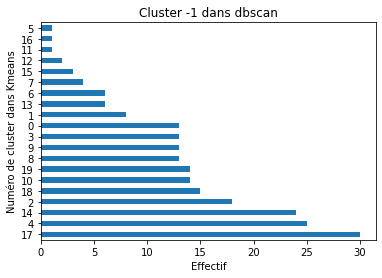

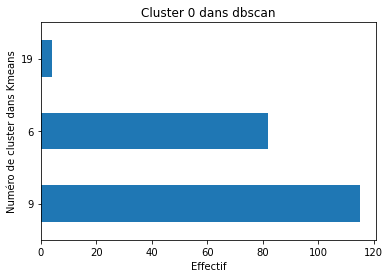

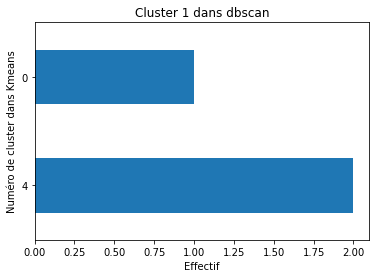

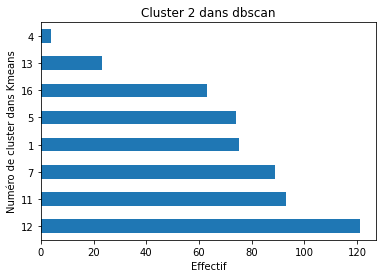

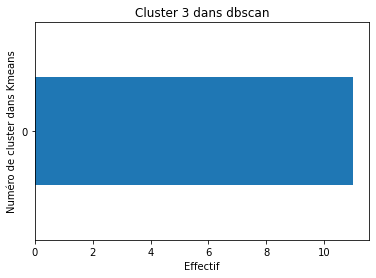

...

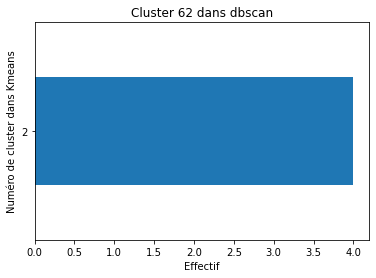

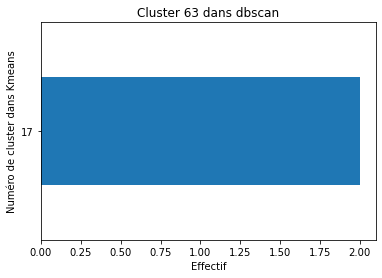

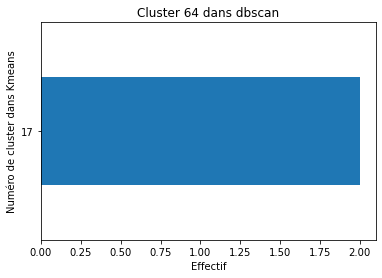

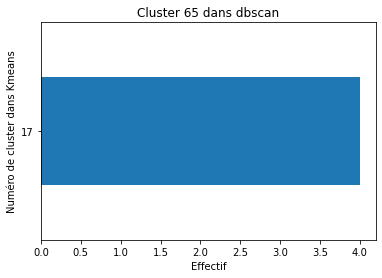

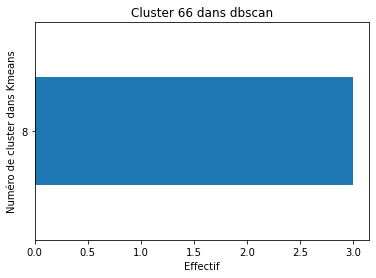

In [28]:
# Histogramme des clusters dans kmeans par rapport à dbscan 
for k in range(-1,int(max(df_comparaison['Clusters DBscan']))+1):
    DF = df_comparaison[df_comparaison['Clusters DBscan']==k][['Couple individus','Clusters Ward','Clusters Kmeans']]
    DF['Clusters Kmeans'].value_counts().plot(kind='barh')
    plt.title('Cluster '+str(k)+ ' dans dbscan')
    plt.xlabel('Effectif')
    plt.ylabel('Numéro de cluster dans Kmeans')
    plt.show()

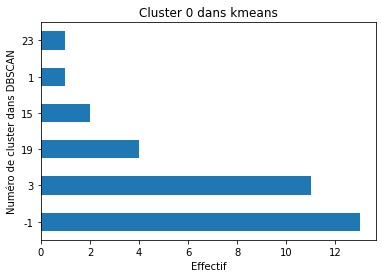

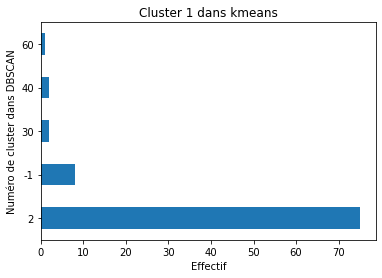

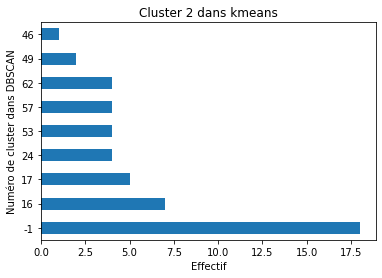

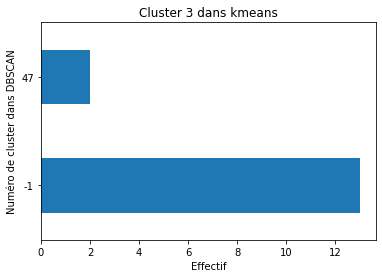

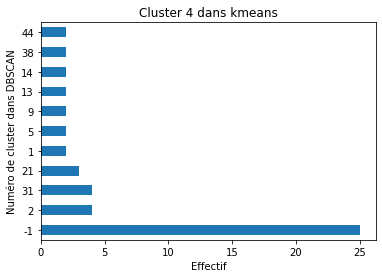

...

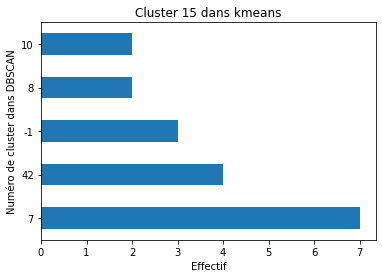

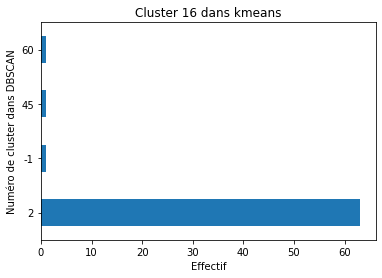

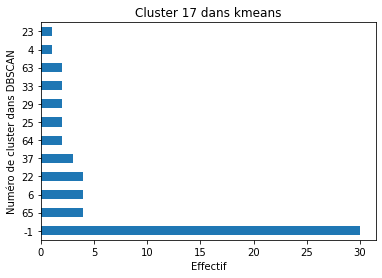

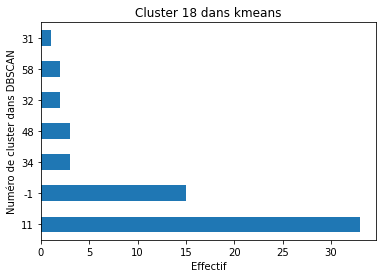

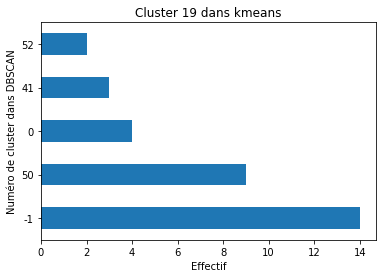

In [29]:
# Histogramme des clusters dans dbscan par rapport à kmeans 
for k in range(0,int(max(df_comparaison['Clusters Kmeans']))+1):
    DF = df_comparaison[df_comparaison['Clusters Kmeans']==k][['Couple individus','Clusters Ward','Clusters DBscan']]
    DF['Clusters DBscan'].value_counts().plot(kind='barh')
    plt.title('Cluster '+str(k)+ ' dans kmeans')
    plt.xlabel('Effectif')
    plt.ylabel('Numéro de cluster dans DBSCAN')
    plt.show()

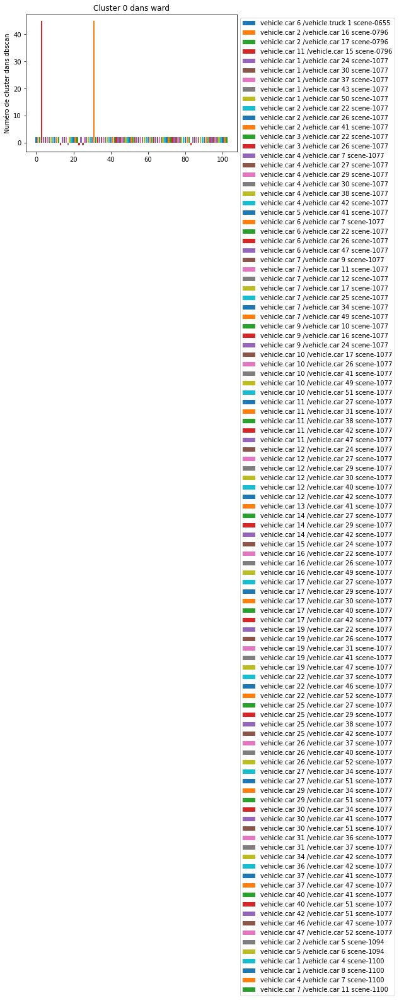

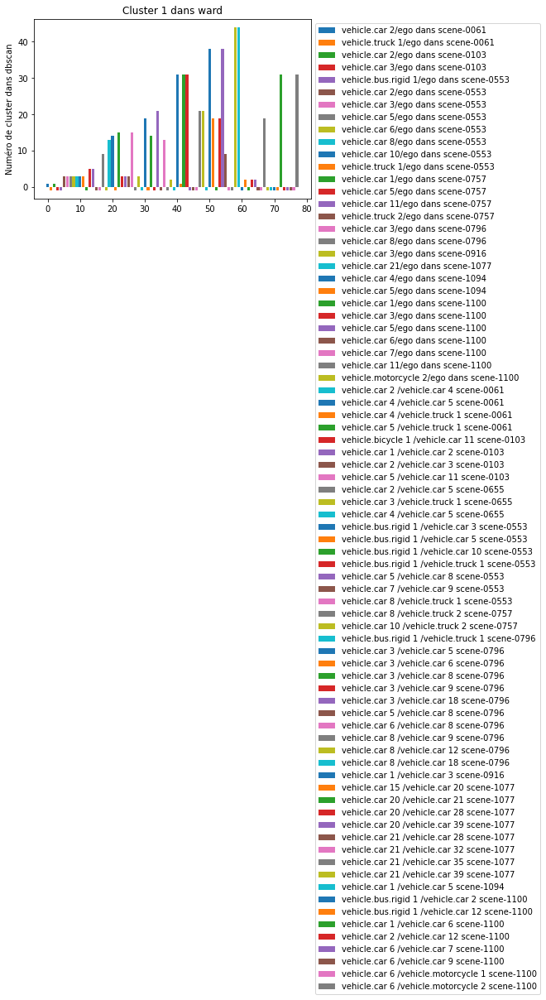

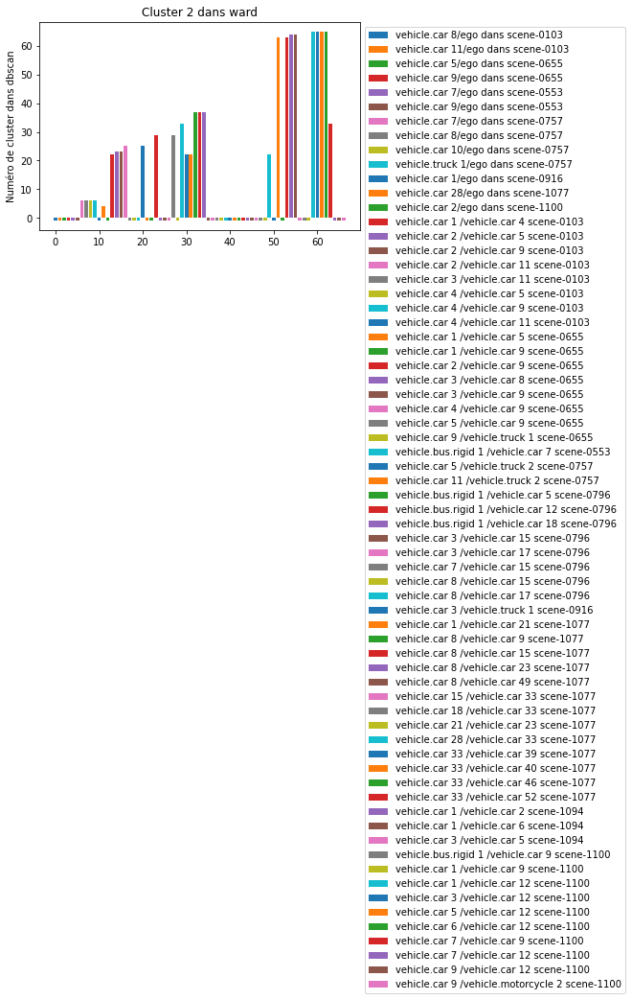

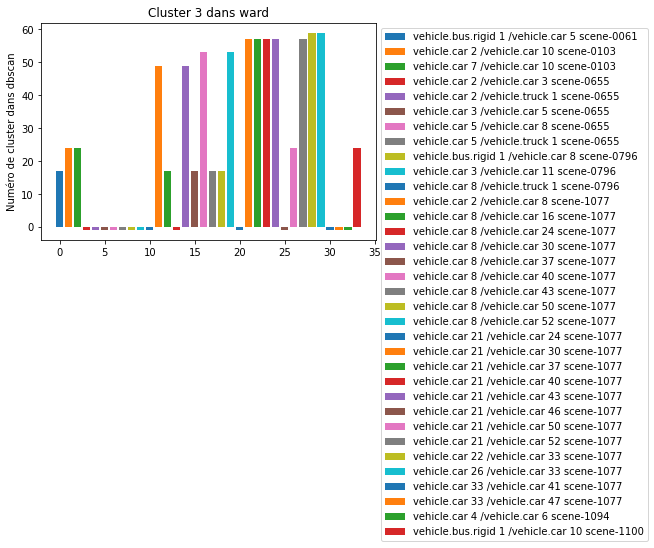

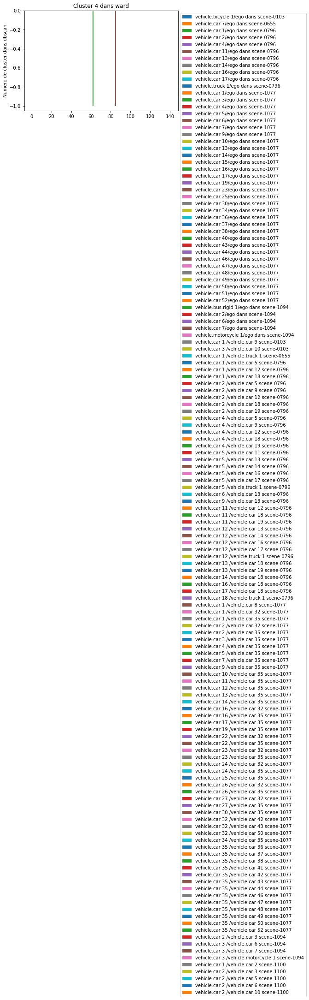

...

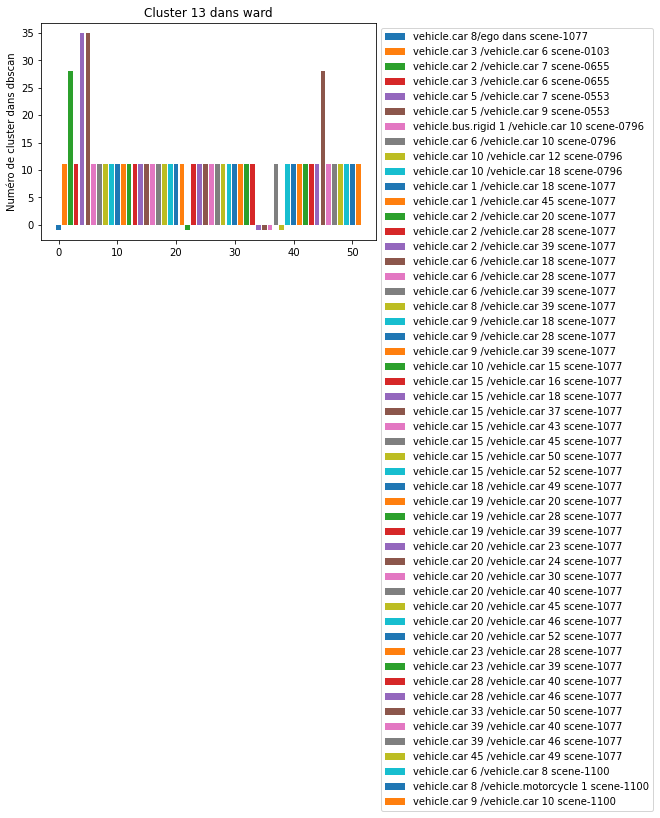

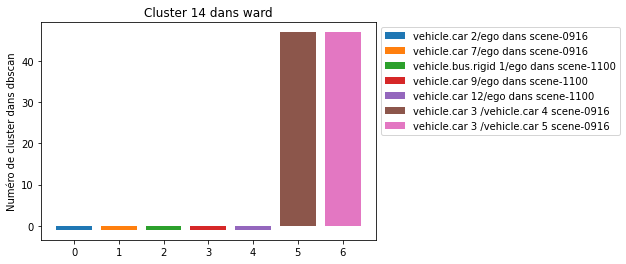

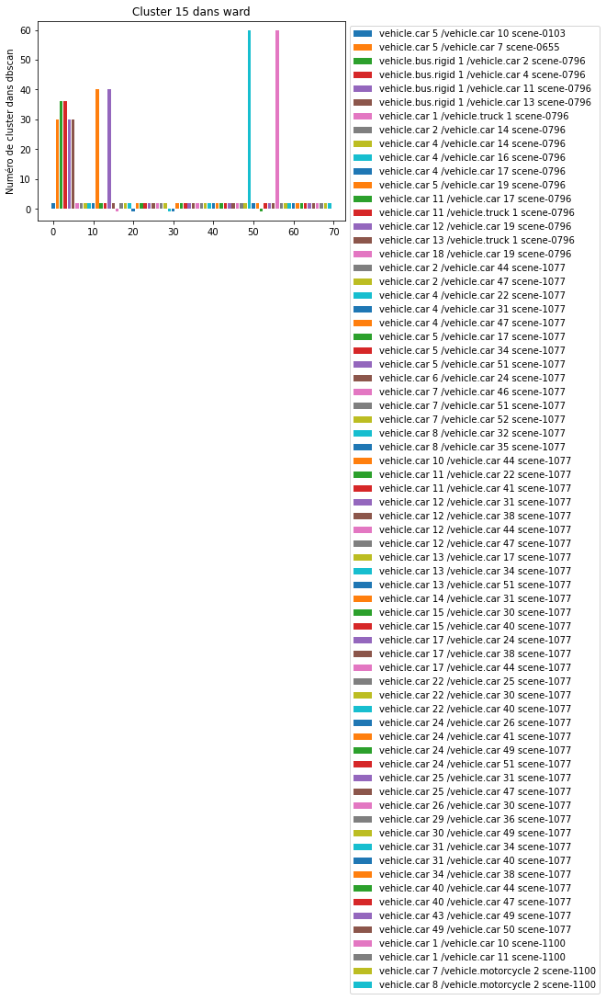

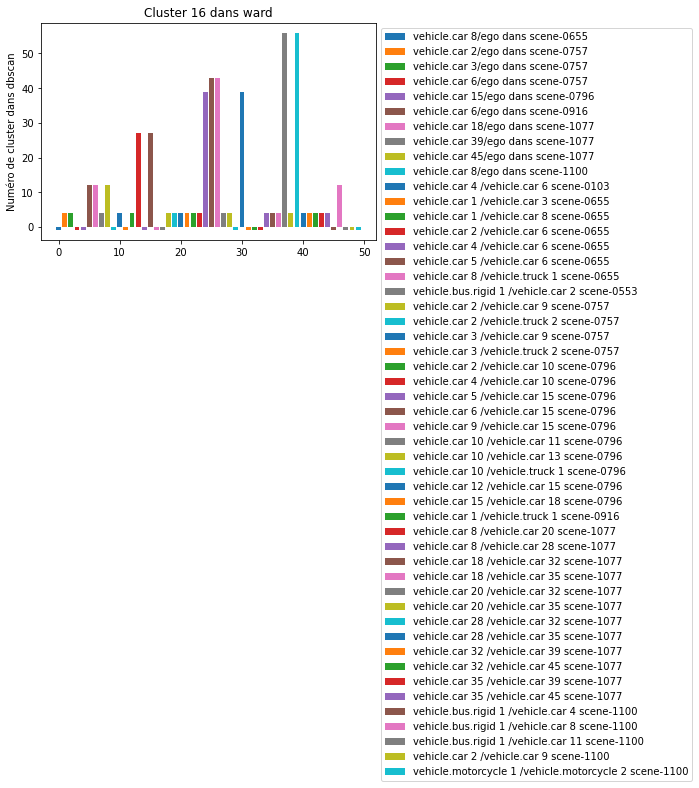

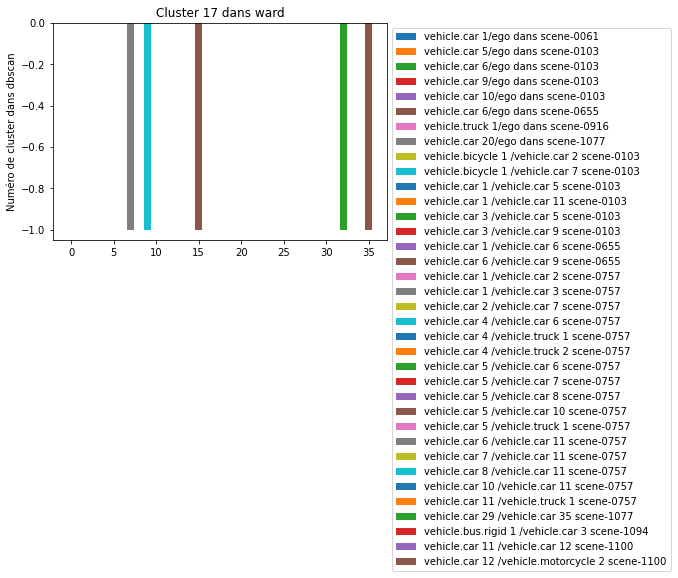

In [30]:
# Répartition des éléments dans dbscan par rapport à ward
for k in range(0,int(max(df_comparaison['Clusters Ward']))+1):
    DF = df_comparaison[df_comparaison['Clusters Ward']==k][['Couple individus','Clusters DBscan','Clusters Kmeans']]
    DF.groupby('Couple individus')
    DF = DF.reset_index(drop=True)
    L = list(DF['Couple individus'].unique())
    plt.figure()
    for j in range(0,len(L)):
        a = DF[DF['Couple individus']==L[j]]
        plt.bar(a.index,a['Clusters DBscan'])
    plt.legend(L,bbox_to_anchor=(1, 1.0),loc='best')
    plt.ylabel('Numéro de cluster dans dbscan')
    plt.title('Cluster '+str(k)+ ' dans ward')
    plt.show()

In [31]:
max(df_comparaison['Clusters DBscan'])

66

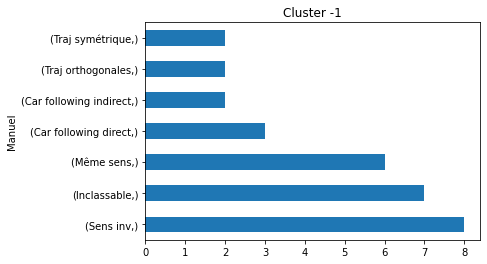

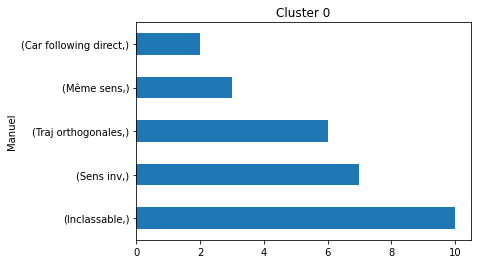

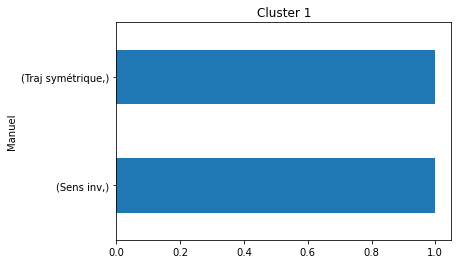

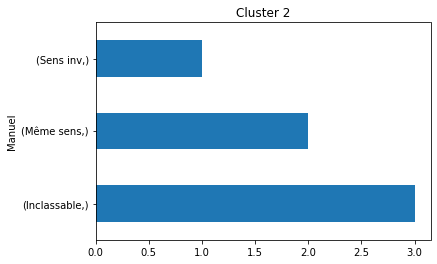

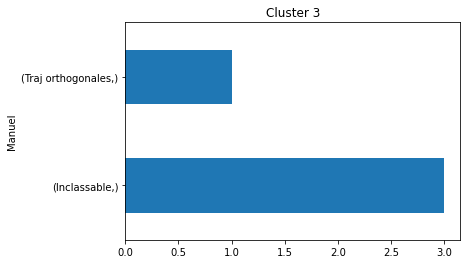

...

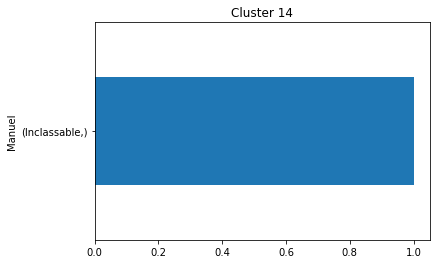

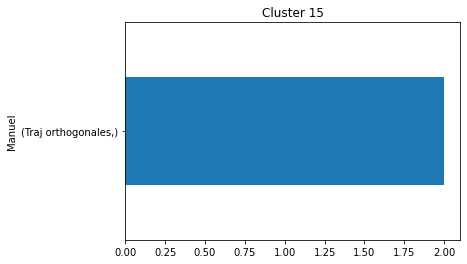

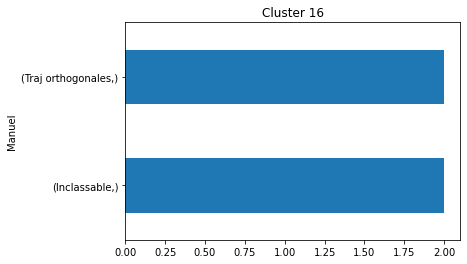

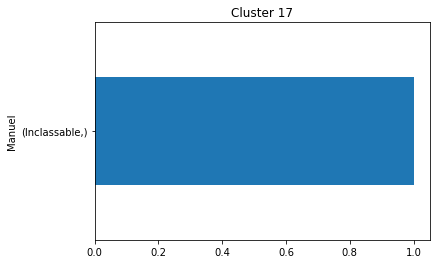

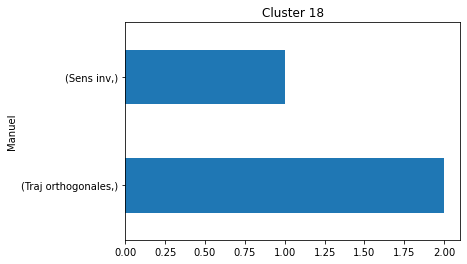

In [32]:
# Analyse du nommage manuel 
for k in range(-1,int(max(df_comparaison['Clusters DBscan']))+1):
    DF = df_comparaison[df_comparaison['Clusters DBscan']==k][['Manuel']]
    if len(DF.value_counts()) !=0:
        DF.value_counts().plot(kind='barh')
        plt.title('Cluster '+str(k))
        plt.show()

### Automatisation du labelling des classes dbscan

In [33]:
# Fonction qui renvoit pour chaque élément une classe selon différents critères

def labelling_auto_dbscan(df,epsilon,nb_voisin):
    
    df_sortante = pd.DataFrame() # La df qu'on va renvoyer 
    
    # ON supprime les Nan de la df
    df = df.dropna()
    
    # Les individus 
    L_indiv = list(df.index)
    df_sortante['Individus'] = L_indiv 
    
    # Les clusters 
    df_bis = df.copy()
    df_bis[list(df_bis.columns[5:])] = StandardScaler().fit_transform(df_bis[list(df_bis.columns[5:])])
    labels = cluster (df_bis[list(df_bis.columns[5:])],epsilon,nb_voisin)
    df_sortante['Cluster Dbscan'] = labels 
    
    # Préparation des liste pour la df_sortante 
    L_ortho = []
    L_sens = []
    L_distance = []
    L_retard = []
    
    # Quantile pour la DTW 
    quantile_30_DTW = df['DTW normalisée'].quantile(0.3)
    quantile_70_DTW = df['DTW normalisée'].quantile(0.7)
    # Quantile pour timelag
    quantile_30_retard = df['TimeLag moyen vertical'].quantile(0.3)
    quantile_70_retard = df['TimeLag moyen vertical'].quantile(0.7)

    # Boucle sur chaque indiv 
    for i in range(0,len(L_indiv)):
        
        Ligne = df.iloc[i:i+1]

        if Ligne["Durée d'interaction"][0]<=0.1:
            L_ortho.append('Inclassable')
            L_sens.append('Inclassable')
            L_distance.append('Inclassable')
            L_retard.append('Inclassable')
            
        else : 
            # Critère d'orthogonalité 
            if Ligne["Indicateur d'orthogonalité moyen"][0]>=0.8 :
                L_ortho.append('Orthogonale')
            elif 0.2 < Ligne["Indicateur d'orthogonalité moyen"][0]<0.8 :
                L_ortho.append('Variable')
            else : 
                L_ortho.append('Colinéaire')
            
            # Critère de sens 
            if Ligne['Sens'][0]==1:
                L_sens.append('Même sens')
            else :
                if L_ortho[-1]=='Orthogonale':
                    L_sens.append('Orthogonale')
                elif L_ortho[-1]=='Variable':
                    L_sens.append('Variable')
                else : 
                    L_sens.append('Sens inverse')
            
            # Critère de distance 
            if Ligne["DTW normalisée"][0]<= quantile_30_DTW:
                L_distance.append('Petite')
            elif quantile_30_DTW < Ligne["DTW normalisée"][0] <= quantile_70_DTW:
                L_distance.append('Moyenne')
            else : 
                L_distance.append('Grande')
                
            #Critère de retard 
            if Ligne["TimeLag moyen vertical"][0]<= quantile_30_retard:
                L_retard.append('Petit')
            elif quantile_30_retard < Ligne["TimeLag moyen vertical"][0] <= quantile_70_retard:
                L_retard.append('Moyen')
            else : 
                L_retard.append('Grand')
        
    df_sortante['Orthogonalité'] = L_ortho
    df_sortante['Sens'] = L_sens
    df_sortante['DTW'] = L_distance
    df_sortante['Retard'] = L_retard
    df_sortante['Concatenation'] = [L_ortho[k]+' '+L_sens[k]+' '+L_distance[k]+' '+L_retard[k] for k in range(len(L_ortho))]
    
    return df_sortante


In [34]:
classe_auto = labelling_auto_dbscan(DF_finale,1.5,2)
classe_auto

,Individus,Cluster Dbscan,Orthogonalité,Sens,DTW,Retard,Concatenation
0,vehicle.bus.rigid 1/ego dans scene-0061,-1,Colinéaire,Sens inverse,Moyenne,Moyen,Colinéaire Sens inverse Moyenne Moyen
1,vehicle.car 1/ego dans scene-0061,0,Inclassable,Inclassable,Inclassable,Inclassable,Inclassable Inclassable Inclassable Inclassable
2,vehicle.car 2/ego dans scene-0061,1,Variable,Même sens,Petite,Grand,Variable Même sens Petite Grand
3,vehicle.car 3/ego dans scene-0061,2,Colinéaire,Même sens,Moyenne,Moyen,Colinéaire Même sens Moyenne Moyen
4,vehicle.car 4/ego dans scene-0061,-1,Colinéaire,Même sens,Petite,Grand,Colinéaire Même sens Petite Grand
...,...,...,...,...,...,...,...
1236,vehicle.car 11 /vehicle.car 12 scene-1100,0,Inclassable,Inclassable,Inclassable,Inclassable,Inclassable Inclassable Inclassable Inclassable
1237,vehicle.car 11 /vehicle.motorcycle 1 scene-1100,66,Orthogonale,Même sens,Moyenne,Grand,Orthogonale Même sens Moyenne Grand
1238,vehicle.car 11 /vehicle.motorcycle 2 scene-1100,2,Colinéaire,Même sens,Petite,Grand,Colinéaire Même sens Petite Grand
1239,vehicle.car 12 /vehicle.motorcycle 2 scene-1100,-1,Colinéaire,Sens inverse,Petite,Grand,Colinéaire Sens inverse Petite Grand


In [35]:
list(classe_auto['Concatenation'].unique())

['Colinéaire Sens inverse Moyenne Moyen',
 'Inclassable Inclassable Inclassable Inclassable',
 'Variable Même sens Petite Grand',
 'Colinéaire Même sens Moyenne Moyen',
 'Colinéaire Même sens Petite Grand',
 'Colinéaire Même sens Moyenne Grand',
 'Colinéaire Sens inverse Petite Petit',
 'Colinéaire Même sens Moyenne Petit',
 'Colinéaire Sens inverse Petite Grand',
 'Orthogonale Orthogonale Moyenne Petit',
 'Variable Variable Petite Moyen',
 'Colinéaire Même sens Petite Petit',
 'Orthogonale Même sens Moyenne Petit',
 'Orthogonale Orthogonale Grande Grand',
 'Orthogonale Même sens Petite Petit',
 'Variable Variable Moyenne Petit',
 'Colinéaire Sens inverse Moyenne Petit',
 'Variable Variable Moyenne Grand',
 'Variable Variable Grande Grand',
 'Orthogonale Même sens Moyenne Grand',
 'Orthogonale Même sens Petite Grand',
 'Orthogonale Orthogonale Moyenne Grand',
 'Orthogonale Orthogonale Petite Grand',
 'Orthogonale Orthogonale Moyenne Moyen',
 'Variable Variable Petite Petit',
 'Variable

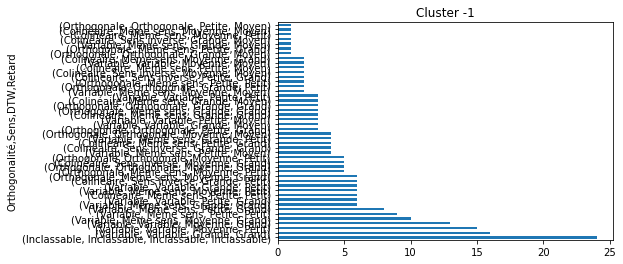

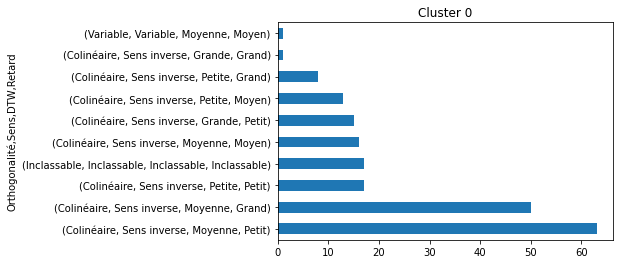

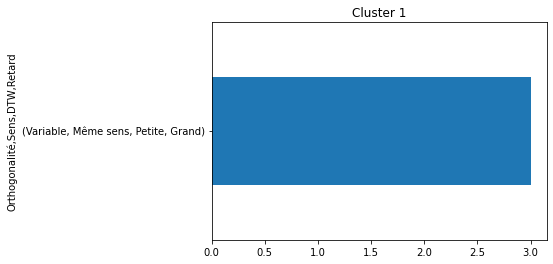

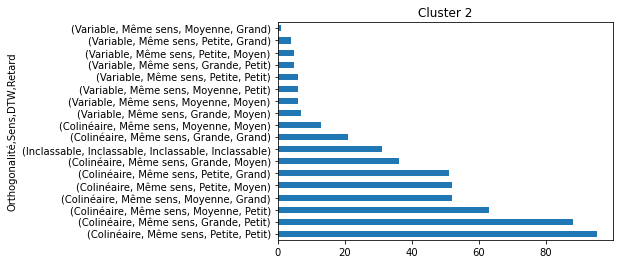

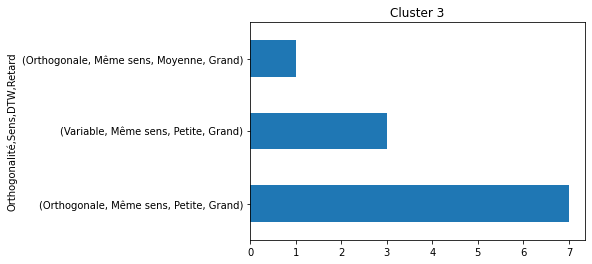

...

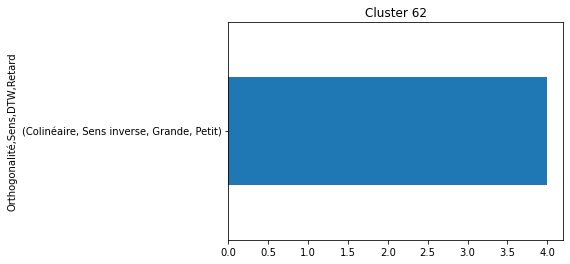

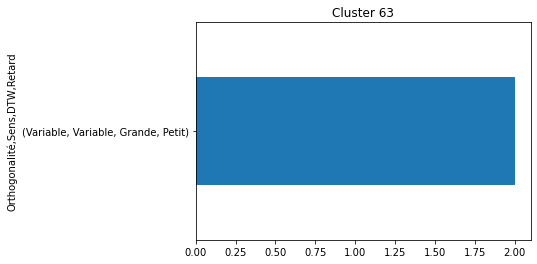

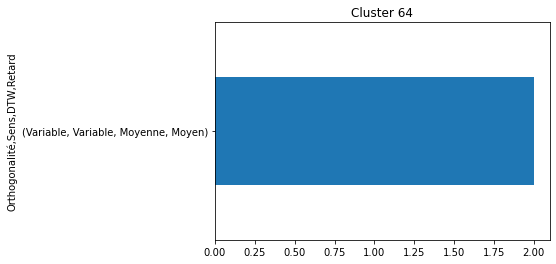

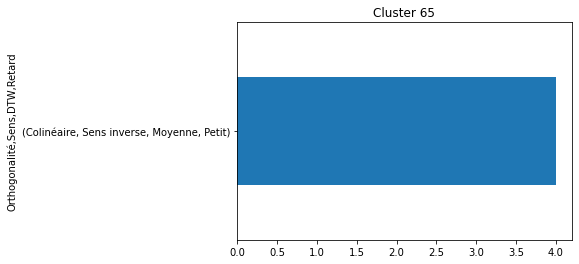

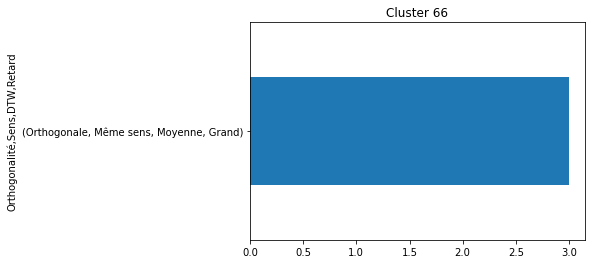

In [36]:
# Analyse du nommage manuel 
for k in range(-1,int(max(classe_auto['Cluster Dbscan']))+1):
    DF = classe_auto[classe_auto['Cluster Dbscan']==k][['Orthogonalité','Sens','DTW','Retard']]
    if len(DF.value_counts()) !=0:
        DF.value_counts().plot(kind='barh')
        plt.title('Cluster '+str(k))
        plt.show()

### Comparaison des classes dbscan et des classes manuelles

In [37]:
## On récupère les classes dbscan 

DF_finale_avec_cluster = DF_finale.dropna()

df_bis = DF_finale.copy()
df_bis = df_bis.dropna()
df_bis[list(df_bis.columns[5:])] = StandardScaler().fit_transform(df_bis[list(df_bis.columns[5:])])
labels = cluster (df_bis[list(df_bis.columns[5:])],1.5,2)
DF_finale_avec_cluster['Cluster Dbscan'] = labels 
DF_finale_avec_cluster

/Users/tiffanydarini/opt/anaconda3/envs/nuscenes/lib/python3.7/site-packages/ipykernel_launcher.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  if __name__ == '__main__':


,scene,Catégorie Véhicule 1,Numéro Véhicule 1,Catégorie Véhicule 2,Numéro Véhicule 2,Vitesse moyenne veh 1,Vitesse moyenne veh 2,Durée d'interaction,DTW normalisée,Distance instantannée moyenne,...,Indicateur d'orthogonalité min,Indicateur d'orthogonalité max,Indicateur de colinéarité moyen,Indicateur de colinéarité min,Indicateur de colinéarité max,Sens,Distance minimale dans matrice distance,Distance maximale dans matrice distance,Distance moyenne dans matrice distance,Cluster Dbscan
vehicle.bus.rigid 1/ego dans scene-0061,scene-0061,vehicle.ego,1,vehicle.bus.rigid,1,8.564618,9.255912,0.107044,62.784244,72.532950,...,0.000274,0.030690,-0.999907,-1.000000,-0.999529,0.0,53.479254,89.795179,71.922482,-1
vehicle.car 1/ego dans scene-0061,scene-0061,vehicle.ego,1,vehicle.car,1,8.862925,9.459852,0.054837,24.953401,32.364935,...,0.063754,0.084432,-0.997027,-0.997966,-0.996429,0.0,20.739661,38.735602,29.578912,0
vehicle.car 2/ego dans scene-0061,scene-0061,vehicle.ego,1,vehicle.car,2,6.155384,5.782350,0.600504,15.844434,26.217761,...,0.092346,0.996106,0.831509,0.088161,0.995727,1.0,6.787707,88.709867,33.192634,1
vehicle.car 3/ego dans scene-0061,scene-0061,vehicle.ego,1,vehicle.car,3,8.564618,11.088804,0.107044,32.294648,38.263151,...,0.036886,0.078373,0.998190,0.996924,0.999319,1.0,23.975892,64.147662,43.973192,2
vehicle.car 4/ego dans scene-0061,scene-0061,vehicle.ego,1,vehicle.car,4,4.775380,3.222342,1.000000,5.050621,14.823187,...,0.000080,0.140614,0.998951,0.990065,1.000000,1.0,0.037589,77.803221,25.983685,-1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
vehicle.car 11 /vehicle.car 12 scene-1100,scene-1100,vehicle.car,11,vehicle.car,12,9.349482,3.690104,0.076904,8.217678,9.876039,...,0.014150,0.109751,-0.996929,-0.999900,-0.993959,0.0,8.300217,13.584201,10.010283,0
vehicle.car 11 /vehicle.motorcycle 1 scene-1100,scene-1100,vehicle.car,11,vehicle.motorcycle,1,10.122451,6.338455,0.384567,49.083647,46.260902,...,0.983084,0.999991,0.123770,0.004190,0.183158,1.0,30.315200,104.297120,64.656899,66
vehicle.car 11 /vehicle.motorcycle 2 scene-1100,scene-1100,vehicle.car,11,vehicle.motorcycle,2,10.122451,11.181889,0.750012,12.551868,29.181995,...,0.001593,0.041305,0.999805,0.999147,0.999999,1.0,0.498520,122.125142,46.623162,2
vehicle.car 12 /vehicle.motorcycle 2 scene-1100,scene-1100,vehicle.car,12,vehicle.motorcycle,2,3.024676,10.319906,0.269163,22.700355,22.612802,...,0.014357,0.248427,-0.981828,-0.999897,-0.968651,0.0,11.473515,51.084325,28.863618,-1


In [38]:
DF_finale_avec_cluster_manuel = DF_finale_avec_cluster.copy()

In [39]:
# Création de la liste correspondant aux clusters manuels
L = []
for k in range(0,len(DF_finale_avec_cluster)):
    ligne = DF_finale_avec_cluster.iloc[k:k+1]
    if ligne['Cluster Dbscan'][0]== 7 or ligne['Cluster Dbscan'][0]== 8 or ligne['Cluster Dbscan'][0]== 10 or ligne['Cluster Dbscan'][0]== 40 or ligne['Cluster Dbscan'][0]== 42 or ligne['Cluster Dbscan'][0]== 60 :
        L.append(0)
    elif ligne['Cluster Dbscan'][0]== 9 or ligne['Cluster Dbscan'][0]== 13 or ligne['Cluster Dbscan'][0]== 14 or ligne['Cluster Dbscan'][0]== 19 or ligne['Cluster Dbscan'][0]== 30 or ligne['Cluster Dbscan'][0]== 31 or ligne['Cluster Dbscan'][0]== 32 or ligne['Cluster Dbscan'][0]== 34 or ligne['Cluster Dbscan'][0]== 36 or ligne['Cluster Dbscan'][0]== 38 or ligne['Cluster Dbscan'][0]== 44 or ligne['Cluster Dbscan'][0]== 45 or ligne['Cluster Dbscan'][0]== 47 or ligne['Cluster Dbscan'][0]== 51 or ligne['Cluster Dbscan'][0]== 55 or ligne['Cluster Dbscan'][0]== 61 or ligne['Cluster Dbscan'][0]== 66:
        L.append(1)
    elif ligne['Cluster Dbscan'][0]== 0 or ligne['Cluster Dbscan'][0]== 2 or ligne['Cluster Dbscan'][0]== 11:
        L.append(3)
    elif ligne['Cluster Dbscan'][0]== 1:
        L.append(4)
    elif ligne['Cluster Dbscan'][0]== 3 or ligne['Cluster Dbscan'][0]== 59 or ligne['Cluster Dbscan'][0]==63 :
        L.append(5)
    elif ligne['Cluster Dbscan'][0]== 4 or ligne['Cluster Dbscan'][0]== 5 or ligne['Cluster Dbscan'][0]== 6 or ligne['Cluster Dbscan'][0]== 20 or ligne['Cluster Dbscan'][0]== 21 or ligne['Cluster Dbscan'][0]== 22 or ligne['Cluster Dbscan'][0]== 23 or ligne['Cluster Dbscan'][0]== 27 or ligne['Cluster Dbscan'][0]== 29 or ligne['Cluster Dbscan'][0]== 56:
        L.append(6)
    elif ligne['Cluster Dbscan'][0]== 35:
        L.append(7)
    elif ligne['Cluster Dbscan'][0]== 26 or ligne['Cluster Dbscan'][0]== 28 or ligne['Cluster Dbscan'][0]== 33 or ligne['Cluster Dbscan'][0]== 48 or ligne['Cluster Dbscan'][0]== 54 or ligne['Cluster Dbscan'][0]== 58 or ligne['Cluster Dbscan'][0]== -1:
        L.append(8)
    else :
        L.append(2)

In [40]:
DF_finale_avec_cluster_manuel['Cluster Manuel'] = L
DF_finale_avec_cluster_manuel

,scene,Catégorie Véhicule 1,Numéro Véhicule 1,Catégorie Véhicule 2,Numéro Véhicule 2,Vitesse moyenne veh 1,Vitesse moyenne veh 2,Durée d'interaction,DTW normalisée,Distance instantannée moyenne,...,Indicateur d'orthogonalité max,Indicateur de colinéarité moyen,Indicateur de colinéarité min,Indicateur de colinéarité max,Sens,Distance minimale dans matrice distance,Distance maximale dans matrice distance,Distance moyenne dans matrice distance,Cluster Dbscan,Cluster Manuel
vehicle.bus.rigid 1/ego dans scene-0061,scene-0061,vehicle.ego,1,vehicle.bus.rigid,1,8.564618,9.255912,0.107044,62.784244,72.532950,...,0.030690,-0.999907,-1.000000,-0.999529,0.0,53.479254,89.795179,71.922482,-1,8
vehicle.car 1/ego dans scene-0061,scene-0061,vehicle.ego,1,vehicle.car,1,8.862925,9.459852,0.054837,24.953401,32.364935,...,0.084432,-0.997027,-0.997966,-0.996429,0.0,20.739661,38.735602,29.578912,0,3
vehicle.car 2/ego dans scene-0061,scene-0061,vehicle.ego,1,vehicle.car,2,6.155384,5.782350,0.600504,15.844434,26.217761,...,0.996106,0.831509,0.088161,0.995727,1.0,6.787707,88.709867,33.192634,1,4
vehicle.car 3/ego dans scene-0061,scene-0061,vehicle.ego,1,vehicle.car,3,8.564618,11.088804,0.107044,32.294648,38.263151,...,0.078373,0.998190,0.996924,0.999319,1.0,23.975892,64.147662,43.973192,2,3
vehicle.car 4/ego dans scene-0061,scene-0061,vehicle.ego,1,vehicle.car,4,4.775380,3.222342,1.000000,5.050621,14.823187,...,0.140614,0.998951,0.990065,1.000000,1.0,0.037589,77.803221,25.983685,-1,8
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
vehicle.car 11 /vehicle.car 12 scene-1100,scene-1100,vehicle.car,11,vehicle.car,12,9.349482,3.690104,0.076904,8.217678,9.876039,...,0.109751,-0.996929,-0.999900,-0.993959,0.0,8.300217,13.584201,10.010283,0,3
vehicle.car 11 /vehicle.motorcycle 1 scene-1100,scene-1100,vehicle.car,11,vehicle.motorcycle,1,10.122451,6.338455,0.384567,49.083647,46.260902,...,0.999991,0.123770,0.004190,0.183158,1.0,30.315200,104.297120,64.656899,66,1
vehicle.car 11 /vehicle.motorcycle 2 scene-1100,scene-1100,vehicle.car,11,vehicle.motorcycle,2,10.122451,11.181889,0.750012,12.551868,29.181995,...,0.041305,0.999805,0.999147,0.999999,1.0,0.498520,122.125142,46.623162,2,3
vehicle.car 12 /vehicle.motorcycle 2 scene-1100,scene-1100,vehicle.car,12,vehicle.motorcycle,2,3.024676,10.319906,0.269163,22.700355,22.612802,...,0.248427,-0.981828,-0.999897,-0.968651,0.0,11.473515,51.084325,28.863618,-1,8


In [41]:
# Fonction qui renvoie une df avec pour chaque cluster les valeurs moyennes de chaque indicateur
# avec en entrée la df contenant déjà les clusters et le nom de la classe
# pour laquelle on calcule les centroides 

def centroide_cluster(df, nom_classe):
    
    df_cluster = pd.DataFrame()
    
    # Liste des labels uniques et dans l'ordre
    labels = df[nom_classe].values
    labels_unique = sorted(list(set(labels)))
    
    Colonne_index = ['Cluster '+str(labels_unique[k]) for k in range(0,len(labels_unique))]
    df_cluster['Cluster']=Colonne_index
    df_cluster = df_cluster.set_index('Cluster') # On met la liste des noms des clusters en index
    
    # ON prépare les listes qui seront dans la df_cluster
    L_liste_traj = []
    L_nbr_element = [] 
    L_vit_veh1 = []
    L_vit_veh2 = []
    L_duree = []
    L_DTW_moy = []
    L_dist_moy = []
    L_DTW_min = []
    L_DTW_max =[]
    L_TL_horizon =[]
    L_TL_vertical = []
    L_indic_ortho_moy = []
    L_indic_ortho_min = []
    L_indic_ortho_max = []
    L_indic_coli_moy = []
    L_indic_coli_min = []
    L_indic_coli_max = []
    L_sens = []
    L_dist_mat_min = []
    L_dist_mat_max = []
    L_dist_mat_moy = []
    
    for s in labels_unique:
        
        # On s'occupe d'un cluster 
        df_bis = df[df[nom_classe]==s]
        nb_ligne = len(df_bis)
        
        L_cluster_s =[]
        
        for j in range(0,nb_ligne):
            current_ligne = df_bis.iloc[j]
            L_cluster_s.append(current_ligne.name) # Nom du couple de traj 
        
        L_liste_traj.append(L_cluster_s)
        L_nbr_element.append(len(L_cluster_s))
        
        L_vit_veh1.append(np.mean(df_bis['Vitesse moyenne veh 1']))
        L_vit_veh2.append(np.mean(df_bis['Vitesse moyenne veh 2']))
        L_duree.append(np.mean(df_bis["Durée d'interaction"]))
        L_DTW_moy.append(np.mean(df_bis['DTW normalisée']))
        L_dist_moy.append(np.mean(df_bis['Distance instantannée moyenne']))
        L_DTW_min.append(np.mean(df_bis["Distance instantannée minimale"]))
        L_DTW_max.append(np.mean(df_bis['Distance instantannée maximale']))
        L_TL_horizon.append(np.mean(df_bis['TimeLag moyen horizontal']))
        L_TL_vertical.append(np.mean(df_bis['TimeLag moyen vertical']))
        L_indic_ortho_moy.append(np.mean(df_bis["Indicateur d'orthogonalité moyen"]))
        L_indic_ortho_min.append(np.mean(df_bis["Indicateur d'orthogonalité min"]))
        L_indic_ortho_max.append(np.mean(df_bis["Indicateur d'orthogonalité max"]))
  
        L_indic_coli_moy.append(np.mean(df_bis['Indicateur de colinéarité moyen']))
        L_indic_coli_min.append(np.mean(df_bis['Indicateur de colinéarité min']))
        L_indic_coli_max.append(np.mean(df_bis['Indicateur de colinéarité max']))
        
        L_sens.append(np.mean(df_bis['Sens']))
        
        L_dist_mat_min.append(np.mean(df_bis['Distance minimale dans matrice distance']))
        L_dist_mat_max.append(np.mean(df_bis['Distance maximale dans matrice distance']))
        L_dist_mat_moy.append(np.mean(df_bis['Distance moyenne dans matrice distance']))
            
    df_cluster['Liste des trajectoires appartenant au cluster'] = L_liste_traj
    df_cluster['Nbre élement dans cluster']=L_nbr_element
    df_cluster['Vitesse veh 1 moyenne'] = L_vit_veh1
    df_cluster['Vitesse veh 2 moyenne'] = L_vit_veh2
    df_cluster['Durée interaction moyenne'] =  L_duree
    df_cluster['DTW moyen'] = L_DTW_moy
    df_cluster['Distance instantannée moyenne moyenne'] = L_dist_moy
    df_cluster['Distance instantannée minimale moyenne'] = L_DTW_min
    df_cluster['Distance instantannée maximale moyenne'] = L_DTW_max
    df_cluster['TimeLag horizontal moyen'] =  L_TL_horizon
    df_cluster['TimeLag vertical moyen'] =  L_TL_vertical
    df_cluster["Indicateur d'orthogonalité moyen" ] = L_indic_ortho_moy
    df_cluster["Indicateur d'orthogonalité minimal moyen" ] = L_indic_ortho_min
    df_cluster["Indicateur d'orthogonalité maximal moyen" ] = L_indic_ortho_max
    df_cluster["Indicateur de colinéarité moyen" ] = L_indic_coli_moy
    df_cluster["Indicateur de colinéarité minimal moyen" ] = L_indic_coli_min
    df_cluster["Indicateur de colinéarité maximal moyen" ] = L_indic_coli_max
    df_cluster['Sens'] = L_sens
    df_cluster["Distance minimale moyenne" ] = L_dist_mat_min
    df_cluster["Distance maximale moyenne" ] = L_dist_mat_max
    df_cluster["Distance moyenne moyenne" ] = L_dist_mat_moy
    
    return df_cluster

In [42]:
centroide_cluster_manuel = centroide_cluster(DF_finale_avec_cluster_manuel,'Cluster Manuel')
centroide_cluster_manuel

,Liste des trajectoires appartenant au cluster,Nbre élement dans cluster,Vitesse veh 1 moyenne,Vitesse veh 2 moyenne,Durée interaction moyenne,DTW moyen,Distance instantannée moyenne moyenne,Distance instantannée minimale moyenne,Distance instantannée maximale moyenne,TimeLag horizontal moyen,...,Indicateur d'orthogonalité moyen,Indicateur d'orthogonalité minimal moyen,Indicateur d'orthogonalité maximal moyen,Indicateur de colinéarité moyen,Indicateur de colinéarité minimal moyen,Indicateur de colinéarité maximal moyen,Sens,Distance minimale moyenne,Distance maximale moyenne,Distance moyenne moyenne
Cluster,,,,,,,,,,,,,,,,,,,,,
Cluster 0,"[vehicle.car 5/ego dans scene-0796, vehicle.ca...",19,12.678603,13.163184,0.852058,31.611335,56.676257,41.313277,73.636093,2.518525,...,0.024241,0.008023,0.068413,0.998932,0.995086,0.999734,1.000000,16.874487,289.698634,110.338407
Cluster 1,"[vehicle.car 8/ego dans scene-0796, vehicle.ca...",42,6.904833,8.285852,0.487049,48.394592,47.444575,32.394749,66.140170,2.404706,...,0.585051,0.332542,0.786734,0.608745,0.297329,0.822470,1.000000,33.585933,102.487164,65.231030
Cluster 2,"[vehicle.car 6/ego dans scene-0916, vehicle.ca...",72,8.051065,9.746456,0.325894,79.742426,68.519934,45.735736,94.163529,1.484752,...,0.281112,0.172269,0.430130,-0.868466,-0.956223,-0.711621,0.027778,60.153228,130.497502,93.009889
Cluster 3,"[vehicle.car 1/ego dans scene-0061, vehicle.ca...",804,10.851882,10.342366,0.388040,48.592013,47.297121,36.179510,59.383886,1.038761,...,0.139767,0.104257,0.196925,0.441590,0.428869,0.453500,0.750000,39.225447,100.863652,64.927422
Cluster 4,"[vehicle.car 2/ego dans scene-0061, vehicle.ca...",3,5.411179,6.011436,0.566117,19.319936,26.721269,13.932066,53.003309,5.299213,...,0.388678,0.032091,0.973382,0.825878,0.210717,0.998574,1.000000,5.248441,93.707218,33.706855
Cluster 5,"[vehicle.car 2/ego dans scene-0553, vehicle.ca...",15,1.574342,7.432728,0.525886,49.947062,53.512573,36.050960,74.510238,0.226791,...,0.798020,0.249224,0.911522,-0.055312,-0.621821,0.541165,0.733333,48.541092,91.459375,67.067107
Cluster 6,"[vehicle.car 2/ego dans scene-0757, vehicle.ca...",46,6.030086,6.569639,0.237404,32.721638,30.215687,23.077619,38.043668,1.398014,...,0.807472,0.586158,0.970201,-0.192060,-0.415782,0.063439,0.152174,29.610434,52.297569,40.080554
Cluster 7,"[vehicle.car 5 /vehicle.car 7 scene-0553, vehi...",2,8.977010,9.308955,0.447193,75.913221,74.944760,62.363894,106.673176,0.000000,...,0.996030,0.993777,0.998946,0.081271,0.043411,0.108415,1.000000,52.879376,156.119361,99.949927
Cluster 8,"[vehicle.bus.rigid 1/ego dans scene-0061, vehi...",238,6.410354,6.891517,0.478084,56.198747,53.505467,37.579567,72.590491,2.970613,...,0.518348,0.326874,0.703157,-0.053679,-0.350743,0.208536,0.470588,45.598701,104.722385,71.287899


In [43]:
# Fonction qui renvoie une df avec pour chaque cluster les valeurs moyennes de chaque indicateur
# avec en entrée la df contenant déjà les clusters et le nom de la classe
# pour laquelle on calcule les centroides 

def centroide_cluster_normalise(df, nom_classe):
    
    df_cluster = pd.DataFrame()
    
    # On normalise les indicateurs 
    df[list(df.columns[5:-2])] = StandardScaler().fit_transform(df[list(df.columns[5:-2])])
    
    # Liste des labels uniques et dans l'ordre
    labels = df[nom_classe].values
    labels_unique = sorted(list(set(labels)))
    
    Colonne_index = ['Cluster '+str(labels_unique[k]) for k in range(0,len(labels_unique))]
    df_cluster['Cluster']=Colonne_index
    df_cluster = df_cluster.set_index('Cluster') # On met la liste des noms des clusters en index
    
    # ON prépare les listes qui seront dans la df_cluster
    L_liste_traj = []
    L_nbr_element = [] 
    L_vit_veh1 = []
    L_vit_veh2 = []
    L_duree = []
    L_DTW_moy = []
    L_dist_moy = []
    L_DTW_min = []
    L_DTW_max =[]
    L_TL_horizon =[]
    L_TL_vertical = []
    L_indic_ortho_moy = []
    L_indic_ortho_min = []
    L_indic_ortho_max = []
    L_indic_coli_moy = []
    L_indic_coli_min = []
    L_indic_coli_max = []
    L_sens = []
    L_dist_mat_min = []
    L_dist_mat_max = []
    L_dist_mat_moy = []
    
    for s in labels_unique:
        
        # On s'occupe d'un cluster 
        df_bis = df[df[nom_classe]==s]
        nb_ligne = len(df_bis)
        
        L_cluster_s =[]
        
        for j in range(0,nb_ligne):
            current_ligne = df_bis.iloc[j]
            L_cluster_s.append(current_ligne.name) # Nom du couple de traj 
        
        L_liste_traj.append(L_cluster_s)
        L_nbr_element.append(len(L_cluster_s))
        
        L_vit_veh1.append(np.mean(df_bis['Vitesse moyenne veh 1']))
        L_vit_veh2.append(np.mean(df_bis['Vitesse moyenne veh 2']))
        L_duree.append(np.mean(df_bis["Durée d'interaction"]))
        L_DTW_moy.append(np.mean(df_bis['DTW normalisée']))
        L_dist_moy.append(np.mean(df_bis['Distance instantannée moyenne']))
        L_DTW_min.append(np.mean(df_bis["Distance instantannée minimale"]))
        L_DTW_max.append(np.mean(df_bis['Distance instantannée maximale']))
        L_TL_horizon.append(np.mean(df_bis['TimeLag moyen horizontal']))
        L_TL_vertical.append(np.mean(df_bis['TimeLag moyen vertical']))
        L_indic_ortho_moy.append(np.mean(df_bis["Indicateur d'orthogonalité moyen"]))
        L_indic_ortho_min.append(np.mean(df_bis["Indicateur d'orthogonalité min"]))
        L_indic_ortho_max.append(np.mean(df_bis["Indicateur d'orthogonalité max"]))
  
        L_indic_coli_moy.append(np.mean(df_bis['Indicateur de colinéarité moyen']))
        L_indic_coli_min.append(np.mean(df_bis['Indicateur de colinéarité min']))
        L_indic_coli_max.append(np.mean(df_bis['Indicateur de colinéarité max']))
        
        L_sens.append(np.mean(df_bis['Sens']))
        
        L_dist_mat_min.append(np.mean(df_bis['Distance minimale dans matrice distance']))
        L_dist_mat_max.append(np.mean(df_bis['Distance maximale dans matrice distance']))
        L_dist_mat_moy.append(np.mean(df_bis['Distance moyenne dans matrice distance']))
            
    df_cluster['Liste des trajectoires appartenant au cluster'] = L_liste_traj
    df_cluster['Nbre élement dans cluster']=L_nbr_element
    df_cluster['Vitesse veh 1 moyenne'] = L_vit_veh1
    df_cluster['Vitesse veh 2 moyenne'] = L_vit_veh2
    df_cluster['Durée interaction moyenne'] =  L_duree
    df_cluster['DTW moyen'] = L_DTW_moy
    df_cluster['Distance instantannée moyenne moyenne'] = L_dist_moy
    df_cluster['Distance instantannée minimale moyenne'] = L_DTW_min
    df_cluster['Distance instantannée maximale moyenne'] = L_DTW_max
    df_cluster['TimeLag horizontal moyen'] =  L_TL_horizon
    df_cluster['TimeLag vertical moyen'] =  L_TL_vertical
    df_cluster["Indicateur d'orthogonalité moyen" ] = L_indic_ortho_moy
    df_cluster["Indicateur d'orthogonalité minimal moyen" ] = L_indic_ortho_min
    df_cluster["Indicateur d'orthogonalité maximal moyen" ] = L_indic_ortho_max
    df_cluster["Indicateur de colinéarité moyen" ] = L_indic_coli_moy
    df_cluster["Indicateur de colinéarité minimal moyen" ] = L_indic_coli_min
    df_cluster["Indicateur de colinéarité maximal moyen" ] = L_indic_coli_max
    df_cluster['Sens'] = L_sens
    df_cluster["Distance minimale moyenne" ] = L_dist_mat_min
    df_cluster["Distance maximale moyenne" ] = L_dist_mat_max
    df_cluster["Distance moyenne moyenne" ] = L_dist_mat_moy
    
    return df_cluster

In [44]:
centroide_cluster_manuel_normalise = centroide_cluster_normalise(DF_finale_avec_cluster_manuel,'Cluster Manuel')
centroide_cluster_manuel_normalise

,Liste des trajectoires appartenant au cluster,Nbre élement dans cluster,Vitesse veh 1 moyenne,Vitesse veh 2 moyenne,Durée interaction moyenne,DTW moyen,Distance instantannée moyenne moyenne,Distance instantannée minimale moyenne,Distance instantannée maximale moyenne,TimeLag horizontal moyen,...,Indicateur d'orthogonalité moyen,Indicateur d'orthogonalité minimal moyen,Indicateur d'orthogonalité maximal moyen,Indicateur de colinéarité moyen,Indicateur de colinéarité minimal moyen,Indicateur de colinéarité maximal moyen,Sens,Distance minimale moyenne,Distance maximale moyenne,Distance moyenne moyenne
Cluster,,,,,,,,,,,,,,,,,,,,,
Cluster 0,"[vehicle.car 5/ego dans scene-0796, vehicle.ca...",19,0.705482,0.895712,1.786528,-0.505612,0.236414,0.152727,0.269252,0.402678,...,-0.752650,-0.566075,-0.803236,0.876717,0.944373,0.776558,0.741157,-0.527426,3.531195,0.990268
Cluster 1,"[vehicle.car 8/ego dans scene-0796, vehicle.ca...",42,-0.546423,-0.275279,0.315488,-0.067781,-0.059646,-0.127592,0.063349,0.356954,...,0.974974,0.514525,1.135603,0.416486,0.157135,0.565623,0.741157,-0.159413,-0.036971,-0.054105
Cluster 2,"[vehicle.car 6/ego dans scene-0916, vehicle.ca...",72,-0.297890,0.075395,-0.333988,0.750001,0.616240,0.291730,0.833116,-0.012609,...,0.038664,-0.019161,0.173083,-1.325904,-1.257174,-1.259867,-1.291176,0.425640,0.496894,0.589060
Cluster 3,"[vehicle.car 1/ego dans scene-0061, vehicle.ca...",804,0.309401,0.218466,-0.083530,-0.062631,-0.064374,-0.008633,-0.122238,-0.191772,...,-0.396761,-0.245629,-0.456366,0.219324,0.305544,0.126568,0.218557,-0.035223,-0.067914,-0.061135
Cluster 4,"[vehicle.car 2/ego dans scene-0061, vehicle.ca...",3,-0.870286,-0.821340,0.634145,-0.826262,-0.724241,-0.707895,-0.297505,1.519735,...,0.370029,-0.485931,1.639390,0.672598,0.059415,0.775178,0.741157,-0.783449,-0.204313,-0.783986
Cluster 5,"[vehicle.car 2/ego dans scene-0553, vehicle.ca...",15,-1.702213,-0.480104,0.472008,-0.027281,0.134955,-0.012673,0.293264,-0.517957,...,1.631043,0.237089,1.472422,-0.366779,-0.879888,0.230885,0.183717,0.169922,-0.247155,-0.011595
Cluster 6,"[vehicle.car 2/ego dans scene-0757, vehicle.ca...",46,-0.736091,-0.687322,-0.690615,-0.476647,-0.612175,-0.420440,-0.708427,-0.047454,...,1.660161,1.359025,1.630804,-0.528075,-0.647426,-0.337585,-1.031138,-0.246960,-0.993562,-0.636416
Cluster 7,"[vehicle.car 5 /vehicle.car 7 scene-0553, vehi...",2,-0.097121,-0.029644,0.154862,0.650107,0.822283,0.814372,1.176740,-0.609063,...,2.241028,2.716334,1.708390,-0.205677,-0.129346,-0.284066,0.741157,0.265458,0.985235,0.749743
Cluster 8,"[vehicle.bus.rigid 1/ego dans scene-0061, vehi...",238,-0.653639,-0.610043,0.279357,0.135808,0.134727,0.035372,0.240531,0.584290,...,0.769487,0.495650,0.910018,-0.364853,-0.574046,-0.164927,-0.365525,0.105126,0.005632,0.086130


In [45]:
# df avec les centroide de dbscan
centroide_cluster_dbscan_normalise = centroide_cluster_normalise(DF_finale_avec_cluster_manuel,'Cluster Dbscan')
centroide_cluster_dbscan_normalise

,Liste des trajectoires appartenant au cluster,Nbre élement dans cluster,Vitesse veh 1 moyenne,Vitesse veh 2 moyenne,Durée interaction moyenne,DTW moyen,Distance instantannée moyenne moyenne,Distance instantannée minimale moyenne,Distance instantannée maximale moyenne,TimeLag horizontal moyen,...,Indicateur d'orthogonalité moyen,Indicateur d'orthogonalité minimal moyen,Indicateur d'orthogonalité maximal moyen,Indicateur de colinéarité moyen,Indicateur de colinéarité minimal moyen,Indicateur de colinéarité maximal moyen,Sens,Distance minimale moyenne,Distance maximale moyenne,Distance moyenne moyenne
Cluster,,,,,,,,,,,,,,,,,,,,,
Cluster -1,"[vehicle.bus.rigid 1/ego dans scene-0061, vehi...",224,-0.667375,-0.583956,0.261736,0.157093,0.162525,0.060252,0.269239,0.607747,...,0.734775,0.448288,0.900265,-0.396594,-0.609841,-0.194490,-0.416028,0.124952,0.034095,0.111860
Cluster 0,"[vehicle.car 1/ego dans scene-0061, vehicle.bi...",201,0.557281,0.460907,-0.419953,-0.336539,-0.378809,-0.742701,0.153860,-0.475238,...,-0.669767,-0.536977,-0.647631,-1.476960,-1.305938,-1.580677,-1.349242,-0.601155,-0.240761,-0.614323
Cluster 1,"[vehicle.car 2/ego dans scene-0061, vehicle.ca...",3,-0.870286,-0.821340,0.634145,-0.826262,-0.724241,-0.707895,-0.297505,1.519735,...,0.370029,-0.485931,1.639390,0.672598,0.059415,0.775178,0.741157,-0.783449,-0.204313,-0.783986
Cluster 2,"[vehicle.car 3/ego dans scene-0061, vehicle.ca...",542,0.267127,0.195397,0.113548,0.004452,0.026522,0.215129,-0.223371,-0.068981,...,-0.567575,-0.434793,-0.611472,0.868279,0.929797,0.772567,0.741157,0.115026,0.022014,0.116223
Cluster 3,"[vehicle.car 2/ego dans scene-0553, vehicle.ca...",11,-2.039609,-0.255633,0.545179,-0.851386,-0.576992,-0.638435,-0.279493,-0.609063,...,1.786665,-0.234685,1.705967,-0.084972,-0.835160,0.766724,0.741157,-0.529364,-0.875105,-0.787498
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
Cluster 62,"[vehicle.car 32 /vehicle.car 34 scene-1077, ve...",4,1.928158,0.647258,-0.894926,1.713630,1.283300,0.373051,1.972206,-0.609063,...,-0.598331,-0.426972,-0.667050,-1.476981,-1.304438,-1.594079,-1.349242,0.717933,1.550959,1.437600
Cluster 63,"[vehicle.car 33 /vehicle.car 40 scene-1077, ve...",2,-1.978441,-0.016938,1.297611,0.439020,0.483678,0.025232,0.582078,-0.609063,...,0.661233,0.933585,0.355158,-1.333833,-1.181001,-1.445043,-1.349242,0.254709,0.276821,0.432034
Cluster 64,"[vehicle.car 1 /vehicle.car 2 scene-1094, vehi...",2,-0.955443,-0.662246,0.269170,0.092915,-0.166217,-0.896451,0.644405,-0.609063,...,0.449422,-0.581901,1.104993,-1.273231,-1.306559,-1.161496,-1.349242,-0.608878,0.173489,-0.166003


In [46]:
# df avec la distance entre les centroide dbscan et les centroides manuels
dist_centro_dbscan_manuel = pd.DataFrame()
dist_centro_dbscan_manuel['Cluster Dbscan\ Cluster Manuel']= list(centroide_cluster_dbscan_normalise.index)
dist_centro_dbscan_manuel = dist_centro_dbscan_manuel.set_index('Cluster Dbscan\ Cluster Manuel')
for k in range(len(centroide_cluster_manuel_normalise)):
    L = []
    for j in range(len(centroide_cluster_dbscan_normalise)):
        dist = [(centroide_cluster_manuel_normalise[column].iloc[k]-centroide_cluster_dbscan_normalise[column].iloc[j])**2 for column in centroide_cluster_dbscan_normalise.columns[2:]]
        L.append(sqrt(sum(dist)))
    dist_centro_dbscan_manuel[list(centroide_cluster_manuel_normalise.index)[k]]=L

In [47]:
dist_centro_dbscan_manuel

,Cluster 0,Cluster 1,Cluster 2,Cluster 3,Cluster 4,Cluster 5,Cluster 6,Cluster 7,Cluster 8
Cluster Dbscan\ Cluster Manuel,,,,,,,,,
Cluster -1,5.730643,1.971836,2.707626,2.907392,3.359775e+00,2.215725,2.867406,4.072922,0.128342
Cluster 0,6.675133,5.083326,3.076460,3.579129,5.803030e+00,5.282198,4.696624,6.710847,4.120959
Cluster 1,6.012046,2.667153,5.691348,4.042992,6.106227e-16,3.663783,4.291299,6.245763,3.304616
Cluster 2,4.244762,2.947895,4.712272,1.334802,4.175272e+00,4.709453,5.241754,5.661097,3.672504
Cluster 3,7.428762,3.412689,5.784263,4.964650,3.268649e+00,2.211651,3.866408,5.983277,3.747400
...,...,...,...,...,...,...,...,...,...
Cluster 62,6.777860,6.765693,3.549599,5.462364,8.370157e+00,7.080729,7.357810,6.441978,5.819039
Cluster 63,6.859911,4.490328,2.864958,4.673538,6.001977e+00,3.810324,4.317979,4.710140,3.293833
Cluster 64,6.776763,4.044699,2.711798,4.086335,4.797937e+00,3.438814,3.586475,5.509750,2.862286


In [48]:
dist_centro_dbscan_manuel.describe()

,Cluster 0,Cluster 1,Cluster 2,Cluster 3,Cluster 4,Cluster 5,Cluster 6,Cluster 7,Cluster 8
count,68.000000,68.000000,68.000000,68.000000,6.800000e+01,68.000000,68.000000,6.800000e+01,68.000000
mean,6.701134,4.511762,4.985577,4.856943,5.333058e+00,4.835499,4.999809,5.668300e+00,4.325526
std,1.656892,1.498088,1.474666,1.341485,1.847624e+00,1.447072,1.927921,1.519683e+00,1.306238
min,2.071866,1.971836,2.308751,1.334802,6.106227e-16,2.211651,1.474851,1.111437e-15,0.128342
25%,5.978753,3.442717,3.879276,4.084344,4.171700e+00,3.837844,3.706174,4.682778e+00,3.579297
50%,6.939159,4.360813,5.094147,4.816832,5.017278e+00,4.488199,4.651570,5.865932e+00,4.048481
75%,7.614224,5.296456,5.821674,5.464241,6.436487e+00,5.544906,6.006416,6.590839e+00,4.778609
max,11.327960,10.529803,8.963558,10.850573,1.235121e+01,10.258765,11.150627,9.620255e+00,9.722411


Text(0, 0.5, 'Cluster DBSCAN')

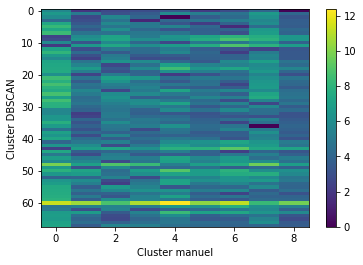

In [49]:
M_manuel = dist_centro_dbscan_manuel.to_numpy()
ax = plt.imshow(M_manuel,aspect='auto',interpolation='none')
plt.colorbar()
plt.xlabel('Cluster manuel')
plt.ylabel('Cluster DBSCAN')

Correspondance clusters

In [50]:
Liste_classe_manuel = ['Car following','Même sens','Véhicules en sens inverse','Beaucoup de couples',\
                      'Traj qui se ressemblent dans le même sens',"Véhicule à l'arrêt","Traj orthogonales",\
                      'Routes qui vont se croiser','Non classable']

In [51]:
df_correspondance_manuel = pd.DataFrame()
df_correspondance_manuel['Cluster Dbscan'] = [k for k in range(-1,67)]

In [52]:
L_min_manuel = []
L_classe_manuel = []
for k in range(-1,67):
    index_min = dist_centro_dbscan_manuel.transpose()['Cluster '+str(k)].idxmin()
    L_min_manuel.append(index_min)
    L_classe_manuel.append(Liste_classe_manuel[int(index_min[8:])])
df_correspondance_manuel['Cluster Manuelle la plus proche'] = L_min_manuel
df_correspondance_manuel['Classe correspondante'] = L_classe_manuel

In [53]:
df_correspondance_manuel

,Cluster Dbscan,Cluster Manuelle la plus proche,Classe correspondante
0,-1,Cluster 8,Non classable
1,0,Cluster 2,Véhicules en sens inverse
2,1,Cluster 4,Traj qui se ressemblent dans le même sens
3,2,Cluster 3,Beaucoup de couples
4,3,Cluster 5,Véhicule à l'arrêt
...,...,...,...
63,62,Cluster 2,Véhicules en sens inverse
64,63,Cluster 2,Véhicules en sens inverse
65,64,Cluster 2,Véhicules en sens inverse
66,65,Cluster 8,Non classable


### Comparaison des classes dbscan et des classes automatiques

In [54]:
# df des classes automatiques 
classe_auto

,Individus,Cluster Dbscan,Orthogonalité,Sens,DTW,Retard,Concatenation
0,vehicle.bus.rigid 1/ego dans scene-0061,-1,Colinéaire,Sens inverse,Moyenne,Moyen,Colinéaire Sens inverse Moyenne Moyen
1,vehicle.car 1/ego dans scene-0061,0,Inclassable,Inclassable,Inclassable,Inclassable,Inclassable Inclassable Inclassable Inclassable
2,vehicle.car 2/ego dans scene-0061,1,Variable,Même sens,Petite,Grand,Variable Même sens Petite Grand
3,vehicle.car 3/ego dans scene-0061,2,Colinéaire,Même sens,Moyenne,Moyen,Colinéaire Même sens Moyenne Moyen
4,vehicle.car 4/ego dans scene-0061,-1,Colinéaire,Même sens,Petite,Grand,Colinéaire Même sens Petite Grand
...,...,...,...,...,...,...,...
1236,vehicle.car 11 /vehicle.car 12 scene-1100,0,Inclassable,Inclassable,Inclassable,Inclassable,Inclassable Inclassable Inclassable Inclassable
1237,vehicle.car 11 /vehicle.motorcycle 1 scene-1100,66,Orthogonale,Même sens,Moyenne,Grand,Orthogonale Même sens Moyenne Grand
1238,vehicle.car 11 /vehicle.motorcycle 2 scene-1100,2,Colinéaire,Même sens,Petite,Grand,Colinéaire Même sens Petite Grand
1239,vehicle.car 12 /vehicle.motorcycle 2 scene-1100,-1,Colinéaire,Sens inverse,Petite,Grand,Colinéaire Sens inverse Petite Grand


In [55]:
# On fait la liste des cluster pour les classes auto 
L = []
Liste_classe_auto = list(classe_auto['Concatenation'].unique())
for k in range(0,len(classe_auto)):
    ligne = classe_auto.iloc[k:k+1]
    classe = list(ligne['Concatenation'])[0]
    L.append(Liste_classe_auto.index(classe))

In [56]:
DF_finale_avec_cluster_auto = DF_finale_avec_cluster.copy()

In [57]:
DF_finale_avec_cluster_auto['Cluster Auto'] = L
DF_finale_avec_cluster_auto

,scene,Catégorie Véhicule 1,Numéro Véhicule 1,Catégorie Véhicule 2,Numéro Véhicule 2,Vitesse moyenne veh 1,Vitesse moyenne veh 2,Durée d'interaction,DTW normalisée,Distance instantannée moyenne,...,Indicateur d'orthogonalité max,Indicateur de colinéarité moyen,Indicateur de colinéarité min,Indicateur de colinéarité max,Sens,Distance minimale dans matrice distance,Distance maximale dans matrice distance,Distance moyenne dans matrice distance,Cluster Dbscan,Cluster Auto
vehicle.bus.rigid 1/ego dans scene-0061,scene-0061,vehicle.ego,1,vehicle.bus.rigid,1,8.564618,9.255912,0.107044,62.784244,72.532950,...,0.030690,-0.999907,-1.000000,-0.999529,0.0,53.479254,89.795179,71.922482,-1,0
vehicle.car 1/ego dans scene-0061,scene-0061,vehicle.ego,1,vehicle.car,1,8.862925,9.459852,0.054837,24.953401,32.364935,...,0.084432,-0.997027,-0.997966,-0.996429,0.0,20.739661,38.735602,29.578912,0,1
vehicle.car 2/ego dans scene-0061,scene-0061,vehicle.ego,1,vehicle.car,2,6.155384,5.782350,0.600504,15.844434,26.217761,...,0.996106,0.831509,0.088161,0.995727,1.0,6.787707,88.709867,33.192634,1,2
vehicle.car 3/ego dans scene-0061,scene-0061,vehicle.ego,1,vehicle.car,3,8.564618,11.088804,0.107044,32.294648,38.263151,...,0.078373,0.998190,0.996924,0.999319,1.0,23.975892,64.147662,43.973192,2,3
vehicle.car 4/ego dans scene-0061,scene-0061,vehicle.ego,1,vehicle.car,4,4.775380,3.222342,1.000000,5.050621,14.823187,...,0.140614,0.998951,0.990065,1.000000,1.0,0.037589,77.803221,25.983685,-1,4
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
vehicle.car 11 /vehicle.car 12 scene-1100,scene-1100,vehicle.car,11,vehicle.car,12,9.349482,3.690104,0.076904,8.217678,9.876039,...,0.109751,-0.996929,-0.999900,-0.993959,0.0,8.300217,13.584201,10.010283,0,1
vehicle.car 11 /vehicle.motorcycle 1 scene-1100,scene-1100,vehicle.car,11,vehicle.motorcycle,1,10.122451,6.338455,0.384567,49.083647,46.260902,...,0.999991,0.123770,0.004190,0.183158,1.0,30.315200,104.297120,64.656899,66,19
vehicle.car 11 /vehicle.motorcycle 2 scene-1100,scene-1100,vehicle.car,11,vehicle.motorcycle,2,10.122451,11.181889,0.750012,12.551868,29.181995,...,0.041305,0.999805,0.999147,0.999999,1.0,0.498520,122.125142,46.623162,2,4
vehicle.car 12 /vehicle.motorcycle 2 scene-1100,scene-1100,vehicle.car,12,vehicle.motorcycle,2,3.024676,10.319906,0.269163,22.700355,22.612802,...,0.248427,-0.981828,-0.999897,-0.968651,0.0,11.473515,51.084325,28.863618,-1,8


In [58]:
centroide_cluster_auto = centroide_cluster(DF_finale_avec_cluster_auto,'Cluster Auto')
centroide_cluster_auto

,Liste des trajectoires appartenant au cluster,Nbre élement dans cluster,Vitesse veh 1 moyenne,Vitesse veh 2 moyenne,Durée interaction moyenne,DTW moyen,Distance instantannée moyenne moyenne,Distance instantannée minimale moyenne,Distance instantannée maximale moyenne,TimeLag horizontal moyen,...,Indicateur d'orthogonalité moyen,Indicateur d'orthogonalité minimal moyen,Indicateur d'orthogonalité maximal moyen,Indicateur de colinéarité moyen,Indicateur de colinéarité minimal moyen,Indicateur de colinéarité maximal moyen,Sens,Distance minimale moyenne,Distance maximale moyenne,Distance moyenne moyenne
Cluster,,,,,,,,,,,,,,,,,,,,,
Cluster 0,"[vehicle.bus.rigid 1/ego dans scene-0061, vehi...",18,11.411503,10.519980,0.321163,38.067725,42.505391,18.878283,73.928599,0.172219,...,0.060939,0.008022,0.178537,-0.994641,-0.999924,-0.972466,0.000000,18.947999,88.688835,40.661210
Cluster 1,"[vehicle.car 1/ego dans scene-0061, vehicle.ca...",107,8.866759,9.490050,0.065465,74.713997,70.014112,66.334093,73.626199,0.406138,...,0.401967,0.387041,0.412869,0.038879,0.022837,0.056088,0.560748,90.592542,103.361686,96.769346
Cluster 2,"[vehicle.car 2/ego dans scene-0061, vehicle.tr...",22,3.153037,6.200602,0.622380,12.847594,23.917295,11.300943,42.196488,3.449924,...,0.488458,0.064980,0.900858,0.633440,-0.073022,0.995609,1.000000,6.134845,60.603891,28.260218
Cluster 3,"[vehicle.car 3/ego dans scene-0061, vehicle.ca...",14,8.901775,11.690702,0.242428,45.739405,44.047612,42.445499,45.480263,1.357278,...,0.064994,0.053395,0.081453,0.996799,0.995630,0.997535,1.000000,45.929462,74.301980,59.957706
Cluster 4,"[vehicle.car 4/ego dans scene-0061, vehicle.ca...",59,9.589744,9.592959,0.691233,14.331805,28.389133,20.116132,36.490211,4.041404,...,0.057560,0.011808,0.154802,0.993246,0.944039,0.999678,1.000000,2.693141,114.246884,44.881104
Cluster 5,"[vehicle.car 5/ego dans scene-0061, vehicle.ca...",56,10.161767,9.636249,0.519315,40.090734,45.130247,35.932773,51.341086,4.447108,...,0.054212,0.021968,0.108260,0.983589,0.955319,0.999343,1.000000,20.272161,106.124443,63.164095
Cluster 6,"[vehicle.bicycle 1/ego dans scene-0103, vehicl...",17,10.140706,8.910563,0.348148,16.688383,18.412403,7.686313,31.918683,0.088246,...,0.040499,0.025671,0.061627,-0.998739,-0.999326,-0.997385,0.000000,7.421485,41.913137,19.594629
Cluster 7,"[vehicle.car 3/ego dans scene-0103, vehicle.bu...",68,10.611970,10.863521,0.454527,45.441753,47.586307,38.781565,55.397424,0.000000,...,0.068288,0.031238,0.130213,0.993133,0.959600,0.998821,1.000000,30.638919,108.662690,67.852117
Cluster 8,"[vehicle.car 5/ego dans scene-0103, vehicle.ca...",10,8.525349,10.076163,0.294867,20.373730,30.523501,9.647502,57.068810,1.200101,...,0.082307,0.003575,0.310290,-0.985405,-0.999981,-0.894363,0.000000,9.046146,64.655097,26.615173


In [59]:
centroide_cluster_auto_normalise = centroide_cluster_normalise(DF_finale_avec_cluster_auto,'Cluster Auto')
centroide_cluster_auto_normalise

,Liste des trajectoires appartenant au cluster,Nbre élement dans cluster,Vitesse veh 1 moyenne,Vitesse veh 2 moyenne,Durée interaction moyenne,DTW moyen,Distance instantannée moyenne moyenne,Distance instantannée minimale moyenne,Distance instantannée maximale moyenne,TimeLag horizontal moyen,...,Indicateur d'orthogonalité moyen,Indicateur d'orthogonalité minimal moyen,Indicateur d'orthogonalité maximal moyen,Indicateur de colinéarité moyen,Indicateur de colinéarité minimal moyen,Indicateur de colinéarité maximal moyen,Sens,Distance minimale moyenne,Distance maximale moyenne,Distance moyenne moyenne
Cluster,,,,,,,,,,,,,,,,,,,,,
Cluster 0,"[vehicle.bus.rigid 1/ego dans scene-0061, vehi...",18,0.430741,0.261109,-0.353054,-0.337182,-0.218045,-0.552430,0.277287,-0.539879,...,-0.639597,-0.566078,-0.505996,-1.474730,-1.306480,-1.570259,-1.349242,-0.481764,-0.299961,-0.622972
Cluster 1,"[vehicle.car 1/ego dans scene-0061, vehicle.ca...",107,-0.121026,0.013835,-1.383556,0.618822,0.664158,0.939160,0.268981,-0.445910,...,0.410969,0.695996,0.126495,-0.255679,-0.152558,-0.346332,-0.177056,1.095961,-0.020303,0.676103
Cluster 2,"[vehicle.car 2/ego dans scene-0061, vehicle.tr...",22,-1.359911,-0.775924,0.860893,-0.995109,-0.814164,-0.790594,-0.594355,0.776839,...,0.677411,-0.376416,1.443640,0.445614,-0.260710,0.771650,0.741157,-0.763929,-0.835247,-0.910093
Cluster 3,"[vehicle.car 3/ego dans scene-0061, vehicle.ca...",14,-0.113434,0.542186,-0.670370,-0.137048,-0.168586,0.188314,-0.504153,-0.063818,...,-0.627105,-0.414993,-0.768038,0.874201,0.944987,0.773941,0.741157,0.112410,-0.574168,-0.176199
Cluster 4,"[vehicle.car 4/ego dans scene-0061, vehicle.ca...",59,0.035736,0.038542,1.138379,-0.956389,-0.670752,-0.513523,-0.751099,1.014448,...,-0.650007,-0.553471,-0.570061,0.870010,0.886780,0.776492,0.741157,-0.839721,0.187164,-0.525268
Cluster 5,"[vehicle.car 5/ego dans scene-0061, vehicle.ca...",56,0.159766,0.048936,0.445525,-0.284407,-0.133866,-0.016388,-0.343164,1.177427,...,-0.660320,-0.519640,-0.695683,0.858620,0.899506,0.776093,0.741157,-0.452604,0.032354,-0.101961
Cluster 6,"[vehicle.bicycle 1/ego dans scene-0103, vehicl...",17,0.155199,-0.125293,-0.244301,-0.894913,-0.990705,-0.904206,-0.876673,-0.573613,...,-0.702566,-0.507308,-0.821553,-1.479564,-1.305805,-1.599911,-1.349242,-0.735595,-1.191484,-1.110727
Cluster 7,"[vehicle.car 3/ego dans scene-0103, vehicle.bu...",68,0.257381,0.343589,0.184421,-0.144813,-0.055100,0.073153,-0.231741,-0.609063,...,-0.616957,-0.488771,-0.636429,0.869877,0.904336,0.775472,0.741157,-0.224311,0.080732,0.006581
Cluster 8,"[vehicle.car 5/ego dans scene-0103, vehicle.ca...",10,-0.195053,0.154554,-0.459032,-0.798772,-0.602303,-0.842564,-0.185830,-0.126959,...,-0.573773,-0.580886,-0.150378,-1.463836,-1.306544,-1.477321,-1.349242,-0.699818,-0.758033,-0.948180


In [60]:
# df avec la distance entre les centroide dbscan et les centroides auto
dist_centro_dbscan_auto = pd.DataFrame()
dist_centro_dbscan_auto['Cluster Dbscan\ Cluster Auto']= list(centroide_cluster_dbscan_normalise.index)
dist_centro_dbscan_auto = dist_centro_dbscan_auto.set_index('Cluster Dbscan\ Cluster Auto')
for k in range(len(centroide_cluster_auto_normalise)):
    L = []
    for j in range(len(centroide_cluster_dbscan_normalise)):
        dist = [(centroide_cluster_auto_normalise[column].iloc[k]-centroide_cluster_dbscan_normalise[column].iloc[j])**2 for column in centroide_cluster_dbscan_normalise.columns[2:]]
        L.append(sqrt(sum(dist)))
    dist_centro_dbscan_auto[list(centroide_cluster_auto_normalise.index)[k]]=L

In [61]:
dist_centro_dbscan_auto

,Cluster 0,Cluster 1,Cluster 2,Cluster 3,Cluster 4,Cluster 5,Cluster 6,Cluster 7,Cluster 8,Cluster 9,...,Cluster 44,Cluster 45,Cluster 46,Cluster 47,Cluster 48,Cluster 49,Cluster 50,Cluster 51,Cluster 52,Cluster 53
Cluster Dbscan\ Cluster Auto,,,,,,,,,,,,,,,,,,,,,
Cluster -1,3.893700,3.015952,3.551918,4.034771,4.230878,3.785400,4.773360,4.043793,3.865630,3.348456,...,5.054115,3.698224,5.044126,8.553536,5.011689,4.190390,2.911738,3.952280,4.176272,4.906797
Cluster 0,0.437055,4.497938,5.822840,4.840474,5.292561,5.145046,1.969423,4.769758,1.659145,5.053095,...,6.598824,6.099674,6.447075,10.788762,4.661535,6.055131,2.201790,6.767379,5.485800,7.368246
Cluster 1,5.730598,5.612744,1.380705,4.353477,3.041538,3.316637,5.944886,4.496594,5.075489,5.283795,...,6.642375,5.158589,6.684128,11.245892,6.994205,5.220886,4.992153,6.048671,4.727394,7.858073
Cluster 2,4.782882,3.582311,4.571650,1.219473,2.676632,1.922012,5.343973,0.874051,5.130393,5.658939,...,3.558985,5.117656,3.383837,10.132395,6.211391,2.734696,4.791640,5.281355,6.354330,7.146550
Cluster 3,5.935926,5.743019,2.236552,5.339002,4.982656,5.172701,6.123219,5.508261,5.151721,4.915243,...,7.483083,5.132551,7.398942,11.191498,7.579338,6.521655,5.020202,5.926405,3.882800,7.361012
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
Cluster 62,4.721092,4.641412,8.780429,6.675447,7.810960,7.017602,6.485124,6.301938,6.078145,6.980844,...,5.209766,7.254357,5.137973,7.804749,4.015885,5.672650,4.893209,6.670990,8.800990,6.182405
Cluster 63,4.135899,4.185186,5.871382,5.894058,6.331535,6.115812,4.978574,5.590910,4.583358,4.320042,...,6.427264,5.496694,6.160934,8.485642,5.373576,6.109552,3.232292,5.377283,5.184767,4.250011
Cluster 64,2.837349,4.383734,4.750774,5.427915,5.582723,5.495522,3.759899,5.154004,2.983458,3.932938,...,6.693885,5.489596,6.456882,9.624424,5.141531,6.089834,1.476240,5.904938,4.392579,5.787665


In [62]:
dist_centro_dbscan_auto.describe()

,Cluster 0,Cluster 1,Cluster 2,Cluster 3,Cluster 4,Cluster 5,Cluster 6,Cluster 7,Cluster 8,Cluster 9,...,Cluster 44,Cluster 45,Cluster 46,Cluster 47,Cluster 48,Cluster 49,Cluster 50,Cluster 51,Cluster 52,Cluster 53
count,68.000000,68.000000,68.000000,68.000000,68.000000,68.000000,68.000000,68.000000,68.000000,68.000000,...,68.000000,68.000000,68.000000,68.000000,68.000000,68.000000,68.000000,68.000000,68.000000,68.000000
mean,5.561612,5.030499,5.450420,5.513609,5.760006,5.511855,6.191420,5.416921,5.663808,5.255965,...,6.313027,5.430391,6.237290,9.548615,6.513186,5.791015,5.017954,5.665052,5.874842,6.490839
std,1.623834,1.302948,1.941302,1.480994,1.582670,1.413697,1.717076,1.535304,1.642848,1.856838,...,1.465297,1.708904,1.471934,2.004467,1.633446,1.327064,1.543093,1.496250,2.118836,1.589419
min,0.437055,3.015952,1.380705,1.219473,2.676632,1.922012,1.969423,0.874051,1.659145,1.022449,...,2.524984,1.236260,2.904711,1.543539,1.394738,1.761575,1.476240,1.594111,2.526136,2.344277
25%,4.706528,4.212013,4.216540,4.737636,4.766490,4.777355,5.291937,4.701037,4.855190,4.165703,...,5.494449,4.426948,5.480416,8.471144,5.561292,5.248222,4.056579,4.923291,4.342854,5.485855
50%,5.512643,4.855863,5.041909,5.633579,5.745310,5.650917,6.037087,5.584832,5.526266,5.087969,...,6.451451,5.444962,6.362019,10.064802,6.742417,5.900658,4.975793,5.808369,5.422823,6.597773
75%,6.417867,5.582072,7.066909,6.249770,6.492736,6.288724,7.176994,6.092798,6.318541,6.402518,...,7.115998,6.290889,7.022835,10.927312,7.493574,6.528220,5.766605,6.463090,7.353882,7.417703
max,11.399930,9.253493,12.741645,11.638448,12.776592,11.760991,12.877529,11.445849,12.217491,10.445547,...,10.034526,10.087921,10.434723,12.914515,9.689539,9.308997,10.688040,9.039459,12.651939,10.409523


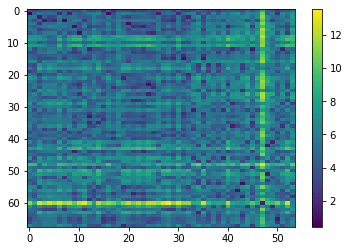

In [63]:
M_auto = dist_centro_dbscan_auto.to_numpy()
ax = plt.imshow(M_auto,aspect='auto',interpolation='none')
plt.colorbar()

Correspondance clusters 

In [64]:
df_correspondance_auto = pd.DataFrame()
df_correspondance_auto['Cluster Dbscan'] = [k for k in range(-1,67)]
#list(dist_centro_dbscan_auto.index)

In [65]:
L_min_auto = []
L_classe_auto = []
for k in range(-1,67):
    index_min = dist_centro_dbscan_auto.transpose()['Cluster '+str(k)].idxmin()
    L_min_auto.append(index_min)
    L_classe_auto.append(Liste_classe_auto[int(index_min[8:])])
df_correspondance_auto['Cluster semi-automatique le plus proche'] = L_min_auto
df_correspondance_auto['Classe correspondante (Orthogonalité, Sens, DTW, Retard)'] = L_classe_auto

In [66]:
df_correspondance_auto.head(12)

,Cluster Dbscan,Cluster semi-automatique le plus proche,"Classe correspondante (Orthogonalité, Sens, DTW, Retard)"
0,-1,Cluster 17,Variable Variable Moyenne Grand
1,0,Cluster 0,Colinéaire Sens inverse Moyenne Moyen
2,1,Cluster 2,Variable Même sens Petite Grand
3,2,Cluster 7,Colinéaire Même sens Moyenne Petit
4,3,Cluster 20,Orthogonale Même sens Petite Grand
5,4,Cluster 9,Orthogonale Orthogonale Moyenne Petit
6,5,Cluster 2,Variable Même sens Petite Grand
7,6,Cluster 10,Variable Variable Petite Moyen
8,7,Cluster 4,Colinéaire Même sens Petite Grand
9,8,Cluster 5,Colinéaire Même sens Moyenne Grand
